## Sentiment analysis of amazon review dataset 2018 
##### Hamsaa SK 

## Importing Libraries

In [3]:
import tensorflow as tf
import tensorflow_hub as hub

from imblearn.under_sampling import RandomUnderSampler
from sklearn.model_selection import train_test_split

import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import seaborn as sns

import os
import json
import gzip
from urllib.request import urlopen

from tensorflow.keras.preprocessing.text import Tokenizer
from tensorflow.keras.preprocessing.sequence import pad_sequences
from tensorflow.keras.utils import plot_model

## Downloading Amazon review 2018 data

In [8]:
# download review data zip file
import wget
!wget http://deepyeti.ucsd.edu/jianmo/amazon/categoryFilesSmall/Cell_Phones_and_Accessories_5.json.gz
!wget http://deepyeti.ucsd.edu/jianmo/amazon/categoryFilesSmall/Arts_Crafts_and_Sewing_5.json.gz
!wget http://deepyeti.ucsd.edu/jianmo/amazon/categoryFilesSmall/Clothing_Shoes_and_Jewelry_5.json.gz
!wget http://deepyeti.ucsd.edu/jianmo/amazon/categoryFilesSmall/Books_5.json.gz
!wget http://deepyeti.ucsd.edu/jianmo/amazon/categoryFilesSmall/Electronics_5.json.gz
!wget http://deepyeti.ucsd.edu/jianmo/amazon/categoryFilesSmall/Home_and_Kitchen_5.json.gz
!wget http://deepyeti.ucsd.edu/jianmo/amazon/categoryFilesSmall/Kindle_Store_5.json.gz
!wget http://deepyeti.ucsd.edu/jianmo/amazon/categoryFilesSmall/Sports_and_Outdoors_5.json.gz
!wget http://deepyeti.ucsd.edu/jianmo/amazon/categoryFilesSmall/Toys_and_Games_5.json.gz

--2022-06-09 11:31:35--  http://deepyeti.ucsd.edu/jianmo/amazon/categoryFilesSmall/Cell_Phones_and_Accessories_5.json.gz
Resolving deepyeti.ucsd.edu (deepyeti.ucsd.edu)... 169.228.63.50
Connecting to deepyeti.ucsd.edu (deepyeti.ucsd.edu)|169.228.63.50|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 169071325 (161M) [application/octet-stream]
Saving to: 'Cell_Phones_and_Accessories_5.json.gz'

     0K .......... .......... .......... .......... ..........  0% 95.2K 28m54s
    50K .......... .......... .......... .......... ..........  0% 33.4K 55m36s
   100K .......... .......... .......... .......... ..........  0%  153M 37m4s
   150K .......... .......... .......... .......... ..........  0%  205M 27m47s
   200K .......... .......... .......... .......... ..........  0%  166K 25m32s
   250K .......... .......... .......... .......... ..........  0% 12.9M 21m18s
   300K .......... .......... .......... .......... ..........  0% 2.84M 18m24s
   350K .......... .

 99600K .......... .......... .......... .......... .......... 60% 2.39M 38s
 99650K .......... .......... .......... .......... .......... 60% 2.35M 38s
 99700K .......... .......... .......... .......... .......... 60% 2.43M 38s
 99750K .......... .......... .......... .......... .......... 60% 2.38M 38s
 99800K .......... .......... .......... .......... .......... 60% 2.37M 38s
 99850K .......... .......... .......... .......... .......... 60% 1.70M 38s
 99900K .......... .......... .......... .......... .......... 60% 3.76M 38s
 99950K .......... .......... .......... .......... .......... 60% 2.44M 38s
100000K .......... .......... .......... .......... .......... 60% 2.34M 38s
100050K .......... .......... .......... .......... .......... 60%  757K 38s
100100K .......... .......... .......... .......... .......... 60% 7.53M 37s
100150K .......... .......... .......... .......... .......... 60% 2.37M 37s
100200K .......... .......... .......... .......... .......... 60% 1.95M 37s

--2022-06-09 11:33:03--  http://deepyeti.ucsd.edu/jianmo/amazon/categoryFilesSmall/Arts_Crafts_and_Sewing_5.json.gz
Resolving deepyeti.ucsd.edu (deepyeti.ucsd.edu)... 169.228.63.50
Connecting to deepyeti.ucsd.edu (deepyeti.ucsd.edu)|169.228.63.50|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 53965563 (51M) [application/octet-stream]
Saving to: 'Arts_Crafts_and_Sewing_5.json.gz'

     0K .......... .......... .......... .......... ..........  0%  118K 7m26s
    50K .......... .......... .......... .......... ..........  0%  189K 6m2s
   100K .......... .......... .......... .......... ..........  0% 12.7M 4m2s
   150K .......... .......... .......... .......... ..........  0% 3.71M 3m5s
   200K .......... .......... .......... .......... ..........  0%  201K 3m20s
   250K .......... .......... .......... .......... ..........  0% 4.82M 2m49s
   300K .......... .......... .......... .......... ..........  0% 2.36M 2m27s
   350K .......... .......... .......... 

  9250K .......... .......... .......... .......... .......... 17% 1.56M 46s
  9300K .......... .......... .......... .......... .......... 17% 1.66M 46s
  9350K .......... .......... .......... .......... .......... 17%  464K 46s
  9400K .......... .......... .......... .......... .......... 17%  664K 46s
  9450K .......... .......... .......... .......... .......... 18% 5.24M 46s
  9500K .......... .......... .......... .......... .......... 18% 3.26M 45s
  9550K .......... .......... .......... .......... .......... 18% 1.86M 45s
  9600K .......... .......... .......... .......... .......... 18% 1.69M 45s
  9650K .......... .......... .......... .......... .......... 18%  454K 45s
  9700K .......... .......... .......... .......... .......... 18%  668K 45s
  9750K .......... .......... .......... .......... .......... 18% 6.75M 45s
  9800K .......... .......... .......... .......... .......... 18% 2.59M 45s
  9850K .......... .......... .......... .......... .......... 18% 2.07M 45s

--2022-06-09 11:33:34--  http://deepyeti.ucsd.edu/jianmo/amazon/categoryFilesSmall/Clothing_Shoes_and_Jewelry_5.json.gz
Resolving deepyeti.ucsd.edu (deepyeti.ucsd.edu)... 169.228.63.50
Connecting to deepyeti.ucsd.edu (deepyeti.ucsd.edu)|169.228.63.50|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 1262892731 (1.2G) [application/octet-stream]
Saving to: 'Clothing_Shoes_and_Jewelry_5.json.gz'

     0K .......... .......... .......... .......... ..........  0% 88.5K 3h52m
    50K .......... .......... .......... .......... ..........  0%  178K 2h53m
   100K .......... .......... .......... .......... ..........  0% 9.54M 1h56m
   150K .......... .......... .......... .......... ..........  0% 3.28M 88m59s
   200K .......... .......... .......... .......... ..........  0%  188K 92m59s
   250K .......... .......... .......... .......... ..........  0% 4.81M 78m11s
   300K .......... .......... .......... .......... ..........  0% 2.41M 68m12s
   350K .......... ....

118150K .......... .......... .......... .......... ..........  9% 2.34M 10m17s
118200K .......... .......... .......... .......... ..........  9% 2.43M 10m17s
118250K .......... .......... .......... .......... ..........  9% 2.39M 10m17s
118300K .......... .......... .......... .......... ..........  9% 1.71M 10m17s
118350K .......... .......... .......... .......... ..........  9% 3.91M 10m17s
118400K .......... .......... .......... .......... ..........  9% 2.34M 10m16s
118450K .......... .......... .......... .......... ..........  9% 2.43M 10m16s
118500K .......... .......... .......... .......... ..........  9% 2.33M 10m16s
118550K .......... .......... .......... .......... ..........  9% 2.45M 10m16s
118600K .......... .......... .......... .......... ..........  9% 2.40M 10m16s
118650K .......... .......... .......... .......... ..........  9% 2.39M 10m16s
118700K .......... .......... .......... .......... ..........  9% 2.34M 10m16s
118750K .......... .......... ..........

124600K .......... .......... .......... .......... .......... 10% 2.38M 10m7s
124650K .......... .......... .......... .......... .......... 10% 2.27M 10m7s
124700K .......... .......... .......... .......... .......... 10% 2.45M 10m7s
124750K .......... .......... .......... .......... .......... 10% 1.25M 10m7s
124800K .......... .......... .......... .......... .......... 10% 5.06M 10m7s
124850K .......... .......... .......... .......... .......... 10% 2.39M 10m7s
124900K .......... .......... .......... .......... .......... 10% 2.27M 10m7s
124950K .......... .......... .......... .......... .......... 10% 1.79M 10m7s
125000K .......... .......... .......... .......... .......... 10% 1.34M 10m7s
125050K .......... .......... .......... .......... .......... 10% 1.77M 10m7s
125100K .......... .......... .......... .......... .......... 10% 7.54M 10m7s
125150K .......... .......... .......... .......... .......... 10% 1.24M 10m7s
125200K .......... .......... .......... .......... 

199550K .......... .......... .......... .......... .......... 16% 1.64M 8m38s
199600K .......... .......... .......... .......... .......... 16% 2.89M 8m38s
199650K .......... .......... .......... .......... .......... 16% 8.31M 8m38s
199700K .......... .......... .......... .......... .......... 16% 2.32M 8m38s
199750K .......... .......... .......... .......... .......... 16% 2.75M 8m38s
199800K .......... .......... .......... .......... .......... 16% 2.44M 8m38s
199850K .......... .......... .......... .......... .......... 16% 1.51M 8m38s
199900K .......... .......... .......... .......... .......... 16% 2.93M 8m38s
199950K .......... .......... .......... .......... .......... 16% 2.24M 8m38s
200000K .......... .......... .......... .......... .......... 16% 3.02M 8m38s
200050K .......... .......... .......... .......... .......... 16% 3.04M 8m38s
200100K .......... .......... .......... .......... .......... 16% 2.39M 8m38s
200150K .......... .......... .......... .......... 

227450K .......... .......... .......... .......... .......... 18% 2.34M 8m15s
227500K .......... .......... .......... .......... .......... 18% 2.44M 8m15s
227550K .......... .......... .......... .......... .......... 18% 1.48M 8m15s
227600K .......... .......... .......... .......... .......... 18% 5.12M 8m15s
227650K .......... .......... .......... .......... .......... 18% 2.43M 8m15s
227700K .......... .......... .......... .......... .......... 18% 1.17M 8m15s
227750K .......... .......... .......... .......... .......... 18% 2.62M 8m15s
227800K .......... .......... .......... .......... .......... 18% 2.50M 8m15s
227850K .......... .......... .......... .......... .......... 18% 3.86M 8m15s
227900K .......... .......... .......... .......... .......... 18% 1.38M 8m15s
227950K .......... .......... .......... .......... .......... 18% 4.67M 8m15s
228000K .......... .......... .......... .......... .......... 18% 2.99M 8m15s
228050K .......... .......... .......... .......... 

324500K .......... .......... .......... .......... .......... 26% 2.35M 7m9s
324550K .......... .......... .......... .......... .......... 26% 2.35M 7m9s
324600K .......... .......... .......... .......... .......... 26% 2.44M 7m9s
324650K .......... .......... .......... .......... .......... 26% 2.38M 7m9s
324700K .......... .......... .......... .......... .......... 26% 2.23M 7m9s
324750K .......... .......... .......... .......... .......... 26% 1.33M 7m9s
324800K .......... .......... .......... .......... .......... 26% 8.79M 7m9s
324850K .......... .......... .......... .......... .......... 26% 2.41M 7m8s
324900K .......... .......... .......... .......... .......... 26% 2.38M 7m8s
324950K .......... .......... .......... .......... .......... 26% 2.39M 7m8s
325000K .......... .......... .......... .......... .......... 26% 2.36M 7m8s
325050K .......... .......... .......... .......... .......... 26% 1.18M 7m8s
325100K .......... .......... .......... .......... .......... 2

349500K .......... .......... .......... .......... .......... 28% 2.17M 6m54s
349550K .......... .......... .......... .......... .......... 28% 1.62M 6m54s
349600K .......... .......... .......... .......... .......... 28% 4.36M 6m54s
349650K .......... .......... .......... .......... .......... 28% 2.12M 6m54s
349700K .......... .......... .......... .......... .......... 28% 2.04M 6m54s
349750K .......... .......... .......... .......... .......... 28% 5.18M 6m54s
349800K .......... .......... .......... .......... .......... 28% 1.62M 6m54s
349850K .......... .......... .......... .......... .......... 28% 2.42M 6m54s
349900K .......... .......... .......... .......... .......... 28% 1.89M 6m54s
349950K .......... .......... .......... .......... .......... 28% 1.06M 6m54s
350000K .......... .......... .......... .......... .......... 28% 4.49M 6m54s
350050K .......... .......... .......... .......... .......... 28% 1.89M 6m54s
350100K .......... .......... .......... .......... 

432550K .......... .......... .......... .......... .......... 35% 1.87M 6m9s
432600K .......... .......... .......... .......... .......... 35% 2.06M 6m9s
432650K .......... .......... .......... .......... .......... 35% 1.08M 6m9s
432700K .......... .......... .......... .......... .......... 35% 5.05M 6m9s
432750K .......... .......... .......... .......... .......... 35% 1.98M 6m9s
432800K .......... .......... .......... .......... .......... 35% 3.63M 6m9s
432850K .......... .......... .......... .......... .......... 35% 1.46M 6m9s
432900K .......... .......... .......... .......... .......... 35% 3.95M 6m9s
432950K .......... .......... .......... .......... .......... 35% 2.14M 6m9s
433000K .......... .......... .......... .......... .......... 35%  958K 6m9s
433050K .......... .......... .......... .......... .......... 35% 8.74M 6m9s
433100K .......... .......... .......... .......... .......... 35% 3.10M 6m9s
433150K .......... .......... .......... .......... .......... 3

456550K .......... .......... .......... .......... .......... 37% 1.93M 5m57s
456600K .......... .......... .......... .......... .......... 37% 3.11M 5m57s
456650K .......... .......... .......... .......... .......... 37% 2.37M 5m57s
456700K .......... .......... .......... .......... .......... 37% 2.29M 5m57s
456750K .......... .......... .......... .......... .......... 37% 2.47M 5m57s
456800K .......... .......... .......... .......... .......... 37% 2.28M 5m57s
456850K .......... .......... .......... .......... .......... 37% 2.42M 5m57s
456900K .......... .......... .......... .......... .......... 37% 2.40M 5m57s
456950K .......... .......... .......... .......... .......... 37% 2.37M 5m57s
457000K .......... .......... .......... .......... .......... 37% 1.75M 5m57s
457050K .......... .......... .......... .......... .......... 37% 3.79M 5m57s
457100K .......... .......... .......... .......... .......... 37% 2.39M 5m57s
457150K .......... .......... .......... .......... 

549400K .......... .......... .......... .......... .......... 44%  132M 5m19s
549450K .......... .......... .......... .......... .......... 44% 2.39M 5m18s
549500K .......... .......... .......... .......... .......... 44% 66.1M 5m18s
549550K .......... .......... .......... .......... .......... 44% 72.6M 5m18s
549600K .......... .......... .......... .......... .......... 44% 69.6M 5m18s
549650K .......... .......... .......... .......... .......... 44% 85.1M 5m18s
549700K .......... .......... .......... .......... .......... 44%  445K 5m18s
549750K .......... .......... .......... .......... .......... 44% 42.8M 5m18s
549800K .......... .......... .......... .......... .......... 44% 96.3M 5m18s
549850K .......... .......... .......... .......... .......... 44%  128M 5m18s
549900K .......... .......... .......... .......... .......... 44%  176M 5m18s
549950K .......... .......... .......... .......... .......... 44%  192M 5m18s
550000K .......... .......... .......... .......... 

583650K .......... .......... .......... .......... .......... 47% 1.65M 5m1s
583700K .......... .......... .......... .......... .......... 47% 5.09M 5m1s
583750K .......... .......... .......... .......... .......... 47% 2.34M 5m1s
583800K .......... .......... .......... .......... .......... 47% 2.47M 5m1s
583850K .......... .......... .......... .......... .......... 47% 2.30M 5m1s
583900K .......... .......... .......... .......... .......... 47% 2.31M 5m1s
583950K .......... .......... .......... .......... .......... 47% 2.46M 5m1s
584000K .......... .......... .......... .......... .......... 47% 1.69M 5m1s
584050K .......... .......... .......... .......... .......... 47% 2.62M 5m1s
584100K .......... .......... .......... .......... .......... 47% 1.16M 5m1s
584150K .......... .......... .......... .......... .......... 47% 4.19M 5m1s
584200K .......... .......... .......... .......... .......... 47% 3.46M 5m1s
584250K .......... .......... .......... .......... .......... 4

674350K .......... .......... .......... .......... .......... 54% 40.5M 4m24s
674400K .......... .......... .......... .......... .......... 54% 21.9M 4m24s
674450K .......... .......... .......... .......... .......... 54% 48.0M 4m24s
674500K .......... .......... .......... .......... .......... 54% 65.0M 4m24s
674550K .......... .......... .......... .......... .......... 54% 50.1M 4m24s
674600K .......... .......... .......... .......... .......... 54% 47.0M 4m23s
674650K .......... .......... .......... .......... .......... 54% 43.3M 4m23s
674700K .......... .......... .......... .......... .......... 54%  239K 4m24s
674750K .......... .......... .......... .......... .......... 54%  182M 4m24s
674800K .......... .......... .......... .......... .......... 54% 1.03M 4m24s
674850K .......... .......... .......... .......... .......... 54%  127M 4m23s
674900K .......... .......... .......... .......... .......... 54%  142M 4m23s
674950K .......... .......... .......... .......... 

690500K .......... .......... .......... .......... .......... 55%  256M 4m16s
690550K .......... .......... .......... .......... .......... 55%  121M 4m16s
690600K .......... .......... .......... .......... .......... 56%  289M 4m15s
690650K .......... .......... .......... .......... .......... 56% 74.4M 4m15s
690700K .......... .......... .......... .......... .......... 56%  300M 4m15s
690750K .......... .......... .......... .......... .......... 56%  369M 4m15s
690800K .......... .......... .......... .......... .......... 56%  174M 4m15s
690850K .......... .......... .......... .......... .......... 56%  292M 4m15s
690900K .......... .......... .......... .......... .......... 56%  166M 4m15s
690950K .......... .......... .......... .......... .......... 56%  340M 4m15s
691000K .......... .......... .......... .......... .......... 56% 3.11M 4m15s
691050K .......... .......... .......... .......... .......... 56% 1.76M 4m15s
691100K .......... .......... .......... .......... 

724300K .......... .......... .......... .......... .......... 58% 2.37M 4m0s
724350K .......... .......... .......... .......... .......... 58% 2.41M 4m0s
724400K .......... .......... .......... .......... .......... 58% 2.37M 4m0s
724450K .......... .......... .......... .......... .......... 58% 2.42M 4m0s
724500K .......... .......... .......... .......... .......... 58% 2.40M 4m0s
724550K .......... .......... .......... .......... .......... 58%  895K 4m0s
724600K .......... .......... .......... .......... .......... 58% 1.95M 4m0s
724650K .......... .......... .......... .......... .......... 58% 7.26M 4m0s
724700K .......... .......... .......... .......... .......... 58% 1.73M 4m0s
724750K .......... .......... .......... .......... .......... 58% 3.74M 4m0s
724800K .......... .......... .......... .......... .......... 58% 2.40M 4m0s
724850K .......... .......... .......... .......... .......... 58% 2.39M 4m0s
724900K .......... .......... .......... .......... .......... 5

749300K .......... .......... .......... .......... .......... 60% 10.4M 3m48s
749350K .......... .......... .......... .......... .......... 60% 2.40M 3m48s
749400K .......... .......... .......... .......... .......... 60% 2.42M 3m48s
749450K .......... .......... .......... .......... .......... 60% 2.38M 3m48s
749500K .......... .......... .......... .......... .......... 60% 1.27M 3m48s
749550K .......... .......... .......... .......... .......... 60%  944K 3m48s
749600K .......... .......... .......... .......... .......... 60% 15.2M 3m48s
749650K .......... .......... .......... .......... .......... 60% 1.76M 3m48s
749700K .......... .......... .......... .......... .......... 60% 4.12M 3m48s
749750K .......... .......... .......... .......... .......... 60% 2.38M 3m48s
749800K .......... .......... .......... .......... .......... 60% 2.38M 3m48s
749850K .......... .......... .......... .......... .......... 60% 2.18M 3m48s
749900K .......... .......... .......... .......... 

824250K .......... .......... .......... .......... .......... 66% 1.86M 3m11s
824300K .......... .......... .......... .......... .......... 66% 1.76M 3m11s
824350K .......... .......... .......... .......... .......... 66% 1.51M 3m11s
824400K .......... .......... .......... .......... .......... 66% 1.73M 3m11s
824450K .......... .......... .......... .......... .......... 66% 1.52M 3m11s
824500K .......... .......... .......... .......... .......... 66% 1.90M 3m11s
824550K .......... .......... .......... .......... .......... 66% 1.61M 3m11s
824600K .......... .......... .......... .......... .......... 66% 7.85M 3m11s
824650K .......... .......... .......... .......... .......... 66% 2.41M 3m11s
824700K .......... .......... .......... .......... .......... 66% 2.37M 3m11s
824750K .......... .......... .......... .......... .......... 66% 2.35M 3m11s
824800K .......... .......... .......... .......... .......... 66% 2.37M 3m11s
824850K .......... .......... .......... .......... 

857700K .......... .......... .......... .......... .......... 69% 2.21M 2m55s
857750K .......... .......... .......... .......... .......... 69% 2.61M 2m55s
857800K .......... .......... .......... .......... .......... 69% 2.44M 2m55s
857850K .......... .......... .......... .......... .......... 69% 1.96M 2m55s
857900K .......... .......... .......... .......... .......... 69% 2.58M 2m55s
857950K .......... .......... .......... .......... .......... 69% 2.03M 2m55s
858000K .......... .......... .......... .......... .......... 69% 3.32M 2m55s
858050K .......... .......... .......... .......... .......... 69% 1.40M 2m55s
858100K .......... .......... .......... .......... .......... 69% 2.23M 2m55s
858150K .......... .......... .......... .......... .......... 69% 9.77M 2m55s
858200K .......... .......... .......... .......... .......... 69% 2.56M 2m55s
858250K .......... .......... .......... .......... .......... 69% 2.06M 2m55s
858300K .......... .......... .......... .......... 

933000K .......... .......... .......... .......... .......... 75% 4.22M 2m19s
933050K .......... .......... .......... .......... .......... 75% 1.58M 2m19s
933100K .......... .......... .......... .......... .......... 75% 5.85M 2m19s
933150K .......... .......... .......... .......... .......... 75% 1.25M 2m19s
933200K .......... .......... .......... .......... .......... 75% 4.23M 2m19s
933250K .......... .......... .......... .......... .......... 75% 3.85M 2m19s
933300K .......... .......... .......... .......... .......... 75% 2.52M 2m19s
933350K .......... .......... .......... .......... .......... 75% 2.38M 2m19s
933400K .......... .......... .......... .......... .......... 75% 1.28M 2m19s
933450K .......... .......... .......... .......... .......... 75% 10.9M 2m19s
933500K .......... .......... .......... .......... .......... 75% 2.31M 2m19s
933550K .......... .......... .......... .......... .......... 75% 2.40M 2m19s
933600K .......... .......... .......... .......... 

974200K .......... .......... .......... .......... .......... 78% 14.5M 2m1s
974250K .......... .......... .......... .......... .......... 78% 2.31M 2m1s
974300K .......... .......... .......... .......... .......... 79% 2.44M 2m1s
974350K .......... .......... .......... .......... .......... 79% 2.41M 2m0s
974400K .......... .......... .......... .......... .......... 79% 1.77M 2m0s
974450K .......... .......... .......... .......... .......... 79% 3.35M 2m0s
974500K .......... .......... .......... .......... .......... 79%  292K 2m0s
974550K .......... .......... .......... .......... .......... 79% 3.58M 2m0s
974600K .......... .......... .......... .......... .......... 79% 2.94M 2m0s
974650K .......... .......... .......... .......... .......... 79% 2.69M 2m0s
974700K .......... .......... .......... .......... .......... 79% 2.44M 2m0s
974750K .......... .......... .......... .......... .......... 79% 2.38M 2m0s
974800K .......... .......... .......... .......... .......... 7

1063350K .......... .......... .......... .......... .......... 86% 2.45M 81s
1063400K .......... .......... .......... .......... .......... 86% 2.20M 81s
1063450K .......... .......... .......... .......... .......... 86% 2.29M 81s
1063500K .......... .......... .......... .......... .......... 86% 2.37M 81s
1063550K .......... .......... .......... .......... .......... 86% 2.53M 81s
1063600K .......... .......... .......... .......... .......... 86% 2.12M 81s
1063650K .......... .......... .......... .......... .......... 86% 2.50M 81s
1063700K .......... .......... .......... .......... .......... 86% 2.57M 81s
1063750K .......... .......... .......... .......... .......... 86% 2.46M 81s
1063800K .......... .......... .......... .......... .......... 86% 2.31M 81s
1063850K .......... .......... .......... .......... .......... 86% 2.53M 81s
1063900K .......... .......... .......... .......... .......... 86% 2.38M 81s
1063950K .......... .......... .......... .......... .......... 

1099150K .......... .......... .......... .......... .......... 89% 1.67M 64s
1099200K .......... .......... .......... .......... .......... 89% 1.65M 64s
1099250K .......... .......... .......... .......... .......... 89% 2.87M 64s
1099300K .......... .......... .......... .......... .......... 89% 2.73M 64s
1099350K .......... .......... .......... .......... .......... 89% 2.71M 64s
1099400K .......... .......... .......... .......... .......... 89% 2.34M 63s
1099450K .......... .......... .......... .......... .......... 89% 3.40M 63s
1099500K .......... .......... .......... .......... .......... 89% 2.16M 63s
1099550K .......... .......... .......... .......... .......... 89% 2.50M 63s
1099600K .......... .......... .......... .......... .......... 89% 1.67M 63s
1099650K .......... .......... .......... .......... .......... 89% 1.35M 63s
1099700K .......... .......... .......... .......... .......... 89% 2.17M 63s
1099750K .......... .......... .......... .......... .......... 

1174100K .......... .......... .......... .......... .......... 95% 2.35M 28s
1174150K .......... .......... .......... .......... .......... 95% 2.45M 28s
1174200K .......... .......... .......... .......... .......... 95% 2.27M 28s
1174250K .......... .......... .......... .......... .......... 95% 2.07M 28s
1174300K .......... .......... .......... .......... .......... 95% 2.94M 28s
1174350K .......... .......... .......... .......... .......... 95% 1.80M 28s
1174400K .......... .......... .......... .......... .......... 95% 3.42M 28s
1174450K .......... .......... .......... .......... .......... 95% 2.36M 28s
1174500K .......... .......... .......... .......... .......... 95% 2.40M 28s
1174550K .......... .......... .......... .......... .......... 95% 2.35M 28s
1174600K .......... .......... .......... .......... .......... 95% 2.41M 28s
1174650K .......... .......... .......... .......... .......... 95% 2.39M 28s
1174700K .......... .......... .......... .......... .......... 

1205950K .......... .......... .......... .......... .......... 97%  727K 13s
1206000K .......... .......... .......... .......... .......... 97% 2.32M 13s
1206050K .......... .......... .......... .......... .......... 97% 2.34M 13s
1206100K .......... .......... .......... .......... .......... 97% 5.18M 13s
1206150K .......... .......... .......... .......... .......... 97% 2.21M 13s
1206200K .......... .......... .......... .......... .......... 97% 2.63M 13s
1206250K .......... .......... .......... .......... .......... 97% 1.94M 13s
1206300K .......... .......... .......... .......... .......... 97% 3.16M 13s
1206350K .......... .......... .......... .......... .......... 97% 1.18M 13s
1206400K .......... .......... .......... .......... .......... 97% 2.31M 13s
1206450K .......... .......... .......... .......... .......... 97% 7.69M 13s
1206500K .......... .......... .......... .......... .......... 97% 1.06M 13s
1206550K .......... .......... .......... .......... .......... 

--2022-06-09 11:43:17--  http://deepyeti.ucsd.edu/jianmo/amazon/categoryFilesSmall/Books_5.json.gz
Resolving deepyeti.ucsd.edu (deepyeti.ucsd.edu)... 169.228.63.50
Connecting to deepyeti.ucsd.edu (deepyeti.ucsd.edu)|169.228.63.50|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 7096438325 (6.6G) [application/octet-stream]
Saving to: 'Books_5.json.gz'

     0K .......... .......... .......... .......... ..........  0% 81.3K 23h41m
    50K .......... .......... .......... .......... ..........  0%  159K 17h53m
   100K .......... .......... .......... .......... ..........  0% 9.01M 11h59m
   150K .......... .......... .......... .......... ..........  0% 3.27M 9h8m
   200K .......... .......... .......... .......... ..........  0%  165K 9h38m
   250K .......... .......... .......... .......... ..........  0% 6.60M 8h5m
   300K .......... .......... .......... .......... ..........  0% 2.40M 7h2m
   350K .......... .......... .......... .......... ..........  0% 2.

103900K .......... .......... .......... .......... ..........  1% 1.40M 63m1s
103950K .......... .......... .......... .......... ..........  1% 1.77M 63m1s
104000K .......... .......... .......... .......... ..........  1% 11.2M 63m0s
104050K .......... .......... .......... .......... ..........  1% 1.79M 63m0s
104100K .......... .......... .......... .......... ..........  1% 1.89M 62m59s
104150K .......... .......... .......... .......... ..........  1% 4.65M 62m58s
104200K .......... .......... .......... .......... ..........  1% 1.34M 62m59s
104250K .......... .......... .......... .......... ..........  1% 2.06M 62m59s
104300K .......... .......... .......... .......... ..........  1% 3.82M 62m58s
104350K .......... .......... .......... .......... ..........  1% 1.87M 62m57s
104400K .......... .......... .......... .......... ..........  1% 2.07M 62m57s
104450K .......... .......... .......... .......... ..........  1% 4.02M 62m56s
104500K .......... .......... .......... ...

212450K .......... .......... .......... .......... ..........  3%  668K 66m11s
212500K .......... .......... .......... .......... ..........  3% 13.9M 66m10s
212550K .......... .......... .......... .......... ..........  3% 2.51M 66m10s
212600K .......... .......... .......... .......... ..........  3% 2.93M 66m9s
212650K .......... .......... .......... .......... ..........  3% 2.39M 66m9s
212700K .......... .......... .......... .......... ..........  3% 2.36M 66m9s
212750K .......... .......... .......... .......... ..........  3% 1.76M 66m9s
212800K .......... .......... .......... .......... ..........  3% 3.66M 66m8s
212850K .......... .......... .......... .......... ..........  3%  405K 66m11s
212900K .......... .......... .......... .......... ..........  3%  673K 66m13s
212950K .......... .......... .......... .......... ..........  3% 11.4M 66m12s
213000K .......... .......... .......... .......... ..........  3% 2.35M 66m11s
213050K .......... .......... .......... ....

324500K .......... .......... .......... .......... ..........  4% 1.62M 59m20s
324550K .......... .......... .......... .......... ..........  4% 2.41M 59m20s
324600K .......... .......... .......... .......... ..........  4% 2.17M 59m20s
324650K .......... .......... .......... .......... ..........  4% 1.31M 59m20s
324700K .......... .......... .......... .......... ..........  4% 5.43M 59m20s
324750K .......... .......... .......... .......... ..........  4% 1.92M 59m20s
324800K .......... .......... .......... .......... ..........  4% 6.01M 59m19s
324850K .......... .......... .......... .......... ..........  4% 1.45M 59m19s
324900K .......... .......... .......... .......... ..........  4% 7.94M 59m19s
324950K .......... .......... .......... .......... ..........  4% 1.07M 59m19s
325000K .......... .......... .......... .......... ..........  4% 9.88M 59m19s
325050K .......... .......... .......... .......... ..........  4% 2.67M 59m19s
325100K .......... .......... ..........

443850K .......... .......... .......... .......... ..........  6% 2.39M 55m5s
443900K .......... .......... .......... .......... ..........  6% 2.37M 55m5s
443950K .......... .......... .......... .......... ..........  6% 2.37M 55m5s
444000K .......... .......... .......... .......... ..........  6% 2.40M 55m5s
444050K .......... .......... .......... .......... ..........  6% 2.41M 55m5s
444100K .......... .......... .......... .......... ..........  6% 2.34M 55m5s
444150K .......... .......... .......... .......... ..........  6% 2.43M 55m5s
444200K .......... .......... .......... .......... ..........  6% 2.36M 55m4s
444250K .......... .......... .......... .......... ..........  6% 1000K 55m5s
444300K .......... .......... .......... .......... ..........  6% 12.7M 55m4s
444350K .......... .......... .......... .......... ..........  6% 6.65M 55m4s
444400K .......... .......... .......... .......... ..........  6% 2.32M 55m4s
444450K .......... .......... .......... .......... 

549450K .......... .......... .......... .......... ..........  7% 3.26M 52m34s
549500K .......... .......... .......... .......... ..........  7% 1.72M 52m34s
549550K .......... .......... .......... .......... ..........  7% 3.19M 52m34s
549600K .......... .......... .......... .......... ..........  7% 2.67M 52m34s
549650K .......... .......... .......... .......... ..........  7% 2.36M 52m34s
549700K .......... .......... .......... .......... ..........  7% 1.03M 52m34s
549750K .......... .......... .......... .......... ..........  7% 12.4M 52m34s
549800K .......... .......... .......... .......... ..........  7% 2.15M 52m34s
549850K .......... .......... .......... .......... ..........  7% 1.52M 52m34s
549900K .......... .......... .......... .......... ..........  7% 13.4M 52m33s
549950K .......... .......... .......... .......... ..........  7% 2.51M 52m33s
550000K .......... .......... .......... .......... ..........  7% 2.31M 52m33s
550050K .......... .......... ..........

673300K .......... .......... .......... .......... ..........  9% 2.37M 52m8s
673350K .......... .......... .......... .......... ..........  9% 2.36M 52m8s
673400K .......... .......... .......... .......... ..........  9% 2.39M 52m8s
673450K .......... .......... .......... .......... ..........  9% 2.43M 52m8s
673500K .......... .......... .......... .......... ..........  9% 2.39M 52m8s
673550K .......... .......... .......... .......... ..........  9% 2.39M 52m8s
673600K .......... .......... .......... .......... ..........  9% 2.35M 52m8s
673650K .......... .......... .......... .......... ..........  9% 2.34M 52m8s
673700K .......... .......... .......... .......... ..........  9% 2.38M 52m7s
673750K .......... .......... .......... .......... ..........  9% 2.38M 52m7s
673800K .......... .......... .......... .......... ..........  9% 2.41M 52m7s
673850K .......... .......... .......... .......... ..........  9% 2.34M 52m7s
673900K .......... .......... .......... .......... 

790250K .......... .......... .......... .......... .......... 11% 2.35M 50m3s
790300K .......... .......... .......... .......... .......... 11% 2.43M 50m3s
790350K .......... .......... .......... .......... .......... 11% 2.37M 50m3s
790400K .......... .......... .......... .......... .......... 11% 2.39M 50m2s
790450K .......... .......... .......... .......... .......... 11% 2.31M 50m2s
790500K .......... .......... .......... .......... .......... 11% 2.41M 50m2s
790550K .......... .......... .......... .......... .......... 11% 2.36M 50m2s
790600K .......... .......... .......... .......... .......... 11% 2.41M 50m2s
790650K .......... .......... .......... .......... .......... 11% 2.33M 50m2s
790700K .......... .......... .......... .......... .......... 11% 2.37M 50m2s
790750K .......... .......... .......... .......... .......... 11% 2.42M 50m2s
790800K .......... .......... .......... .......... .......... 11% 2.40M 50m2s
790850K .......... .......... .......... .......... 

899400K .......... .......... .......... .......... .......... 12% 2.43M 48m46s
899450K .......... .......... .......... .......... .......... 12% 2.37M 48m46s
899500K .......... .......... .......... .......... .......... 12% 2.38M 48m46s
899550K .......... .......... .......... .......... .......... 12% 2.40M 48m45s
899600K .......... .......... .......... .......... .......... 12% 2.37M 48m45s
899650K .......... .......... .......... .......... .......... 12% 2.38M 48m45s
899700K .......... .......... .......... .......... .......... 12% 2.32M 48m45s
899750K .......... .......... .......... .......... .......... 12% 2.48M 48m45s
899800K .......... .......... .......... .......... .......... 12% 2.37M 48m45s
899850K .......... .......... .......... .......... .......... 12% 2.36M 48m45s
899900K .......... .......... .......... .......... .......... 12% 2.41M 48m45s
899950K .......... .......... .......... .......... .......... 12% 2.33M 48m45s
900000K .......... .......... ..........

999350K .......... .......... .......... .......... .......... 14% 2.37M 47m23s
999400K .......... .......... .......... .......... .......... 14% 2.40M 47m23s
999450K .......... .......... .......... .......... .......... 14% 2.41M 47m23s
999500K .......... .......... .......... .......... .......... 14% 2.37M 47m23s
999550K .......... .......... .......... .......... .......... 14% 2.34M 47m23s
999600K .......... .......... .......... .......... .......... 14% 2.42M 47m23s
999650K .......... .......... .......... .......... .......... 14% 2.38M 47m23s
999700K .......... .......... .......... .......... .......... 14% 2.38M 47m23s
999750K .......... .......... .......... .......... .......... 14% 2.32M 47m23s
999800K .......... .......... .......... .......... .......... 14% 2.30M 47m23s
999850K .......... .......... .......... .......... .......... 14% 2.61M 47m23s
999900K .......... .......... .......... .......... .......... 14% 2.37M 47m23s
999950K .......... .......... ..........

1124350K .......... .......... .......... .......... .......... 16% 2.37M 45m50s
1124400K .......... .......... .......... .......... .......... 16% 2.43M 45m50s
1124450K .......... .......... .......... .......... .......... 16% 2.43M 45m50s
1124500K .......... .......... .......... .......... .......... 16% 2.35M 45m50s
1124550K .......... .......... .......... .......... .......... 16% 2.32M 45m50s
1124600K .......... .......... .......... .......... .......... 16% 2.46M 45m50s
1124650K .......... .......... .......... .......... .......... 16% 1.99M 45m50s
1124700K .......... .......... .......... .......... .......... 16% 1.34M 45m50s
1124750K .......... .......... .......... .......... .......... 16% 3.02M 45m50s
1124800K .......... .......... .......... .......... .......... 16% 1.37M 45m50s
1124850K .......... .......... .......... .......... .......... 16% 2.53M 45m50s
1124900K .......... .......... .......... .......... .......... 16% 1.26M 45m50s
1124950K .......... ........

1249300K .......... .......... .......... .......... .......... 18% 2.37M 45m1s
1249350K .......... .......... .......... .......... .......... 18% 2.38M 45m1s
1249400K .......... .......... .......... .......... .......... 18% 2.39M 45m1s
1249450K .......... .......... .......... .......... .......... 18% 2.40M 45m0s
1249500K .......... .......... .......... .......... .......... 18% 2.38M 45m0s
1249550K .......... .......... .......... .......... .......... 18% 2.39M 45m0s
1249600K .......... .......... .......... .......... .......... 18% 2.31M 45m0s
1249650K .......... .......... .......... .......... .......... 18% 2.39M 45m0s
1249700K .......... .......... .......... .......... .......... 18% 2.38M 45m0s
1249750K .......... .......... .......... .......... .......... 18% 2.36M 45m0s
1249800K .......... .......... .......... .......... .......... 18% 2.41M 45m0s
1249850K .......... .......... .......... .......... .......... 18% 2.38M 45m0s
1249900K .......... .......... .........

1361950K .......... .......... .......... .......... .......... 19% 2.34M 45m9s
1362000K .......... .......... .......... .......... .......... 19% 2.36M 45m9s
1362050K .......... .......... .......... .......... .......... 19% 2.37M 45m9s
1362100K .......... .......... .......... .......... .......... 19% 2.37M 45m9s
1362150K .......... .......... .......... .......... .......... 19% 2.40M 45m9s
1362200K .......... .......... .......... .......... .......... 19% 2.43M 45m9s
1362250K .......... .......... .......... .......... .......... 19% 2.37M 45m9s
1362300K .......... .......... .......... .......... .......... 19% 2.39M 45m9s
1362350K .......... .......... .......... .......... .......... 19% 2.32M 45m9s
1362400K .......... .......... .......... .......... .......... 19% 2.45M 45m9s
1362450K .......... .......... .......... .......... .......... 19% 2.33M 45m9s
1362500K .......... .......... .......... .......... .......... 19% 2.42M 45m9s
1362550K .......... .......... .........

1474300K .......... .......... .......... .......... .......... 21% 3.62M 44m30s
1474350K .......... .......... .......... .......... .......... 21% 2.43M 44m30s
1474400K .......... .......... .......... .......... .......... 21% 2.43M 44m30s
1474450K .......... .......... .......... .......... .......... 21% 2.29M 44m30s
1474500K .......... .......... .......... .......... .......... 21% 2.53M 44m30s
1474550K .......... .......... .......... .......... .......... 21% 1.90M 44m30s
1474600K .......... .......... .......... .......... .......... 21% 2.83M 44m30s
1474650K .......... .......... .......... .......... .......... 21% 2.36M 44m30s
1474700K .......... .......... .......... .......... .......... 21% 1.91M 44m30s
1474750K .......... .......... .......... .......... .......... 21% 3.32M 44m30s
1474800K .......... .......... .......... .......... .......... 21% 2.41M 44m30s
1474850K .......... .......... .......... .......... .......... 21% 1.09M 44m30s
1474900K .......... ........

1584300K .......... .......... .......... .......... .......... 22% 2.42M 43m25s
1584350K .......... .......... .......... .......... .......... 22% 1.68M 43m25s
1584400K .......... .......... .......... .......... .......... 22% 2.06M 43m25s
1584450K .......... .......... .......... .......... .......... 22% 1.14M 43m25s
1584500K .......... .......... .......... .......... .......... 22% 6.99M 43m25s
1584550K .......... .......... .......... .......... .......... 22% 2.01M 43m25s
1584600K .......... .......... .......... .......... .......... 22% 2.73M 43m25s
1584650K .......... .......... .......... .......... .......... 22% 2.48M 43m25s
1584700K .......... .......... .......... .......... .......... 22% 2.33M 43m25s
1584750K .......... .......... .......... .......... .......... 22% 2.43M 43m25s
1584800K .......... .......... .......... .......... .......... 22%  589K 43m25s
1584850K .......... .......... .......... .......... .......... 22% 13.6M 43m25s
1584900K .......... ........

1724200K .......... .......... .......... .......... .......... 24% 11.1M 41m55sIOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)


1974200K .......... .......... .......... .......... .......... 28% 1.76M 41m6s
1974250K .......... .......... .......... .......... .......... 28% 2.57M 41m6s
1974300K .......... .......... .......... .......... .......... 28% 1.64M 41m6s
1974350K .......... .......... .......... .......... .......... 28% 2.30M 41m6s
1974400K .......... .......... .......... .......... .......... 28% 2.46M 41m6s
1974450K .......... .......... .......... .......... .......... 28% 2.44M 41m6s
1974500K .......... .......... .......... .......... .......... 28% 2.26M 41m6s
1974550K .......... .......... 

2101800K .......... .......... .......... .......... .......... 30% 2.41M 39m51s
2101850K .......... .......... .......... .......... .......... 30% 1.93M 39m51s
2101900K .......... .......... .......... .......... .......... 30% 1.13M 39m51s
2101950K .......... .......... .......... .......... .......... 30% 13.0M 39m51s
2102000K .......... .......... .......... .......... .......... 30% 2.55M 39m51s
2102050K .......... .......... .......... .......... .......... 30% 1.46M 39m51s
2102100K .......... .......... .......... .......... .......... 30% 2.59M 39m51s
2102150K .......... .......... .......... .......... .......... 30% 3.71M 39m51s
2102200K .......... .......... .......... .......... .......... 30% 2.39M 39m51s
2102250K .......... .......... .......... .......... .......... 30% 2.31M 39m51s
2102300K .......... .......... .......... .......... .......... 30% 2.35M 39m51s
2102350K .......... .......... .......... .......... .......... 30% 2.11M 39m51s
2102400K .......... ........

2209400K .......... .......... .......... .......... .......... 31% 2.32M 38m48s
2209450K .......... .......... .......... .......... .......... 31% 68.3M 38m48s
2209500K .......... .......... .......... .......... .......... 31% 63.8M 38m48s
2209550K .......... .......... .......... .......... .......... 31% 83.3M 38m48s
2209600K .......... .......... .......... .......... .......... 31% 49.0M 38m48s
2209650K .......... .......... .......... .......... .......... 31% 85.6M 38m48s
2209700K .......... .......... .......... .......... .......... 31% 84.1M 38m48s
2209750K .......... .......... .......... .......... .......... 31% 59.3M 38m47s
2209800K .......... .......... .......... .......... .......... 31% 58.4M 38m47s
2209850K .......... .......... .......... .......... .......... 31% 52.9M 38m47s
2209900K .......... .......... .......... .......... .......... 31% 42.5M 38m47s
2209950K .......... .......... .......... .......... .......... 31% 42.9M 38m47s
2210000K .......... ........

2332150K .......... .......... .......... .......... .......... 33% 2.47M 37m31s
2332200K .......... .......... .......... .......... .......... 33% 1.80M 37m31s
2332250K .......... .......... .......... .......... .......... 33% 3.21M 37m31s
2332300K .......... .......... .......... .......... .......... 33% 1.39M 37m31s
2332350K .......... .......... .......... .......... .......... 33% 7.69M 37m31s
2332400K .......... .......... .......... .......... .......... 33% 2.48M 37m31s
2332450K .......... .......... .......... .......... .......... 33% 2.41M 37m31s
2332500K .......... .......... .......... .......... .......... 33% 2.40M 37m31s
2332550K .......... .......... .......... .......... .......... 33% 2.36M 37m31s
2332600K .......... .......... .......... .......... .......... 33% 2.41M 37m31s
2332650K .......... .......... .......... .......... .......... 33% 2.27M 37m31s
2332700K .......... .......... .......... .......... .......... 33% 2.47M 37m31s
2332750K .......... ........

2449050K .......... .......... .......... .......... .......... 35% 2.41M 36m21s
2449100K .......... .......... .......... .......... .......... 35% 2.36M 36m21s
2449150K .......... .......... .......... .......... .......... 35% 2.33M 36m21s
2449200K .......... .......... .......... .......... .......... 35% 2.48M 36m21s
2449250K .......... .......... .......... .......... .......... 35% 2.37M 36m21s
2449300K .......... .......... .......... .......... .......... 35% 2.39M 36m21s
2449350K .......... .......... .......... .......... .......... 35% 2.38M 36m21s
2449400K .......... .......... .......... .......... .......... 35% 1019K 36m21s
2449450K .......... .......... .......... .......... .......... 35% 12.8M 36m21s
2449500K .......... .......... .......... .......... .......... 35% 2.71M 36m21s
2449550K .......... .......... .......... .......... .......... 35% 1.46M 36m21s
2449600K .......... .......... .......... .......... .......... 35% 6.78M 36m21s
2449650K .......... ........

2574050K .......... .......... .......... .......... .......... 37% 1.01M 35m16s
2574100K .......... .......... .......... .......... .......... 37% 11.2M 35m16s
2574150K .......... .......... .......... .......... .......... 37% 3.12M 35m16s
2574200K .......... .......... .......... .......... .......... 37% 2.44M 35m16s
2574250K .......... .......... .......... .......... .......... 37% 1.97M 35m16s
2574300K .......... .......... .......... .......... .......... 37% 2.15M 35m16s
2574350K .......... .......... .......... .......... .......... 37% 1.79M 35m16s
2574400K .......... .......... .......... .......... .......... 37% 7.18M 35m16s
2574450K .......... .......... .......... .......... .......... 37% 1.72M 35m16s
2574500K .......... .......... .......... .......... .......... 37% 1.64M 35m16s
2574550K .......... .......... .......... .......... .......... 37% 1.15M 35m16s
2574600K .......... .......... .......... .......... .......... 37%  786K 35m16s
2574650K .......... ........

2699000K .......... .......... .......... .......... .......... 38% 2.02M 34m29s
2699050K .......... .......... .......... .......... .......... 38% 3.77M 34m29s
2699100K .......... .......... .......... .......... .......... 38% 2.44M 34m29s
2699150K .......... .......... .......... .......... .......... 38% 2.30M 34m29s
2699200K .......... .......... .......... .......... .......... 38% 1.65M 34m29s
2699250K .......... .......... .......... .......... .......... 38% 2.00M 34m29s
2699300K .......... .......... .......... .......... .......... 38% 1.71M 34m29s
2699350K .......... .......... .......... .......... .......... 38% 1.67M 34m29s
2699400K .......... .......... .......... .......... .......... 38% 1.64M 34m29s
2699450K .......... .......... .......... .......... .......... 38% 1.32M 34m29s
2699500K .......... .......... .......... .......... .......... 38% 3.82M 34m29s
2699550K .......... .......... .......... .......... .......... 38% 1.34M 34m29s
2699600K .......... ........

2804700K .......... .......... .......... .......... .......... 40% 2.31M 33m33s
2804750K .......... .......... .......... .......... .......... 40% 2.46M 33m33s
2804800K .......... .......... .......... .......... .......... 40% 2.38M 33m33s
2804850K .......... .......... .......... .......... .......... 40% 2.40M 33m33s
2804900K .......... .......... .......... .......... .......... 40% 2.38M 33m33s
2804950K .......... .......... .......... .......... .......... 40% 2.35M 33m33s
2805000K .......... .......... .......... .......... .......... 40% 2.42M 33m33s
2805050K .......... .......... .......... .......... .......... 40% 2.34M 33m33s
2805100K .......... .......... .......... .......... .......... 40% 2.42M 33m33s
2805150K .......... .......... .......... .......... .......... 40% 2.39M 33m33s
2805200K .......... .......... .......... .......... .......... 40% 2.39M 33m33s
2805250K .......... .......... .......... .......... .......... 40% 2.29M 33m33s
2805300K .......... ........

2923950K .......... .......... .......... .......... .......... 42% 1.37M 32m32s
2924000K .......... .......... .......... .......... .......... 42% 1.39M 32m32s
2924050K .......... .......... .......... .......... .......... 42% 8.21M 32m32s
2924100K .......... .......... .......... .......... .......... 42% 1.53M 32m32s
2924150K .......... .......... .......... .......... .......... 42% 4.05M 32m32s
2924200K .......... .......... .......... .......... .......... 42% 3.12M 32m32s
2924250K .......... .......... .......... .......... .......... 42% 2.03M 32m32s
2924300K .......... .......... .......... .......... .......... 42% 1.77M 32m32s
2924350K .......... .......... .......... .......... .......... 42% 6.76M 32m32s
2924400K .......... .......... .......... .......... .......... 42%  416K 32m32s
2924450K .......... .......... .......... .......... .......... 42% 16.6M 32m32s
2924500K .......... .......... .......... .......... .......... 42% 1.06M 32m32s
2924550K .......... ........

3023950K .......... .......... .......... .......... .......... 43% 1.29M 31m41s
3024000K .......... .......... .......... .......... .......... 43% 12.4M 31m41s
3024050K .......... .......... .......... .......... .......... 43% 2.44M 31m41s
3024100K .......... .......... .......... .......... .......... 43% 1.46M 31m41s
3024150K .......... .......... .......... .......... .......... 43% 2.27M 31m41s
3024200K .......... .......... .......... .......... .......... 43% 6.33M 31m41s
3024250K .......... .......... .......... .......... .......... 43% 2.26M 31m41s
3024300K .......... .......... .......... .......... .......... 43% 2.41M 31m41s
3024350K .......... .......... .......... .......... .......... 43% 2.20M 31m41s
3024400K .......... .......... .......... .......... .......... 43% 1.79M 31m41s
3024450K .......... .......... .......... .......... .......... 43% 2.63M 31m41s
3024500K .......... .......... .......... .......... .......... 43%  986K 31m41s
3024550K .......... ........

3141650K .......... .......... .......... .......... .......... 45% 2.39M 31m35s
3141700K .......... .......... .......... .......... .......... 45% 1.49M 31m35s
3141750K .......... .......... .......... .......... .......... 45% 3.16M 31m35s
3141800K .......... .......... .......... .......... .......... 45% 3.60M 31m35s
3141850K .......... .......... .......... .......... .......... 45% 1.96M 31m35s
3141900K .......... .......... .......... .......... .......... 45% 2.17M 31m35s
3141950K .......... .......... .......... .......... .......... 45% 1.64M 31m35s
3142000K .......... .......... .......... .......... .......... 45% 4.25M 31m35s
3142050K .......... .......... .......... .......... .......... 45% 1.74M 31m35s
3142100K .......... .......... .......... .......... .......... 45% 4.36M 31m35s
3142150K .......... .......... .......... .......... .......... 45% 2.35M 31m35s
3142200K .......... .......... .......... .......... .......... 45% 1.88M 31m35s
3142250K .......... ........

3248900K .......... .......... .......... .......... .......... 46% 2.47M 30m38s
3248950K .......... .......... .......... .......... .......... 46% 2.38M 30m38s
3249000K .......... .......... .......... .......... .......... 46% 2.37M 30m38s
3249050K .......... .......... .......... .......... .......... 46% 2.30M 30m38s
3249100K .......... .......... .......... .......... .......... 46% 2.39M 30m38s
3249150K .......... .......... .......... .......... .......... 46% 2.37M 30m38s
3249200K .......... .......... .......... .......... .......... 46% 2.41M 30m38s
3249250K .......... .......... .......... .......... .......... 46% 2.28M 30m38s
3249300K .......... .......... .......... .......... .......... 46% 2.48M 30m38s
3249350K .......... .......... .......... .......... .......... 46% 2.39M 30m38s
3249400K .......... .......... .......... .......... .......... 46% 2.35M 30m38s
3249450K .......... .......... .......... .......... .......... 46% 2.44M 30m38s
3249500K .......... ........

3373850K .......... .......... .......... .......... .......... 48% 2.21M 29m44s
3373900K .......... .......... .......... .......... .......... 48% 1.97M 29m44s
3373950K .......... .......... .......... .......... .......... 48% 1.37M 29m44s
3374000K .......... .......... .......... .......... .......... 48%  725K 29m44s
3374050K .......... .......... .......... .......... .......... 48% 12.6M 29m43s
3374100K .......... .......... .......... .......... .......... 48% 2.33M 29m43s
3374150K .......... .......... .......... .......... .......... 48% 2.47M 29m43s
3374200K .......... .......... .......... .......... .......... 48% 2.33M 29m43s
3374250K .......... .......... .......... .......... .......... 48% 2.43M 29m43s
3374300K .......... .......... .......... .......... .......... 48% 2.21M 29m43s
3374350K .......... .......... .......... .......... .......... 48% 2.58M 29m43s
3374400K .......... .......... .......... .......... .......... 48% 2.21M 29m43s
3374450K .......... ........

3498850K .......... .......... .......... .......... .......... 50% 2.28M 28m35s
3498900K .......... .......... .......... .......... .......... 50% 1.54M 28m35s
3498950K .......... .......... .......... .......... .......... 50% 4.62M 28m35s
3499000K .......... .......... .......... .......... .......... 50% 1.98M 28m35s
3499050K .......... .......... .......... .......... .......... 50% 3.50M 28m35s
3499100K .......... .......... .......... .......... .......... 50% 1.43M 28m35s
3499150K .......... .......... .......... .......... .......... 50% 7.21M 28m35s
3499200K .......... .......... .......... .......... .......... 50% 2.21M 28m35s
3499250K .......... .......... .......... .......... .......... 50% 2.55M 28m35s
3499300K .......... .......... .......... .......... .......... 50% 2.22M 28m35s
3499350K .......... .......... .......... .......... .......... 50% 2.10M 28m35s
3499400K .......... .......... .......... .......... .......... 50% 3.10M 28m35s
3499450K .......... ........

3637700K .......... .......... .......... .......... .......... 52% 2.48M 27m21s
3637750K .......... .......... .......... .......... .......... 52% 1.55M 27m21s
3637800K .......... .......... .......... .......... .......... 52% 5.25M 27m21s
3637850K .......... .......... .......... .......... .......... 52% 2.32M 27m21s
3637900K .......... .......... .......... .......... .......... 52%  542K 27m21s
3637950K .......... .......... .......... .......... .......... 52%  437K 27m21s
3638000K .......... .......... .......... .......... .......... 52% 3.09M 27m21s
3638050K .......... .......... .......... .......... .......... 52% 3.87M 27m21s
3638100K .......... .......... .......... .......... .......... 52% 1.60M 27m21s
3638150K .......... .......... .......... .......... .......... 52% 2.98M 27m21s
3638200K .......... .......... .......... .......... .......... 52% 2.90M 27m21s
3638250K .......... .......... .......... .......... .......... 52% 2.58M 27m21s
3638300K .......... ........

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)

4198700K .......... .......... .......... .......... .......... 60% 6.41M 22m35s
4198750K .......... .......... .......... .......... .......... 60% 2.45M 22m35s
4198800K .......... .......... .......... .......... .......... 60% 2.17M 22m35s
4198850K .......... .......... .......... .......... .......... 60% 2.52M 22m35s
4198900K .......... .......... .......... .......... .......... 60% 2.36M 22m35s
4198950K .......... .......... .......... .......... .......... 60% 2.43M 22m34s
4199000K .......... .......... .......... .......... .......... 60% 2.31M 22m34s
4199050K .......... .......... .......... .......... .......... 60% 2.28M 22m34s
4199100K .......... ....

4298650K .......... .......... .......... .......... .......... 62% 2.40M 21m46s
4298700K .......... .......... .......... .......... .......... 62%  252K 21m46s
4298750K .......... .......... .......... .......... .......... 62% 6.22M 21m46s
4298800K .......... .......... .......... .......... .......... 62% 2.30M 21m46s
4298850K .......... .......... .......... .......... .......... 62% 2.43M 21m46s
4298900K .......... .......... .......... .......... .......... 62% 2.36M 21m46s
4298950K .......... .......... .......... .......... .......... 62% 2.39M 21m46s
4299000K .......... .......... .......... .......... .......... 62% 2.38M 21m46s
4299050K .......... .......... .......... .......... .......... 62%  253K 21m46s
4299100K .......... .......... .......... .......... .......... 62% 5.58M 21m46s
4299150K .......... .......... .......... .......... .......... 62% 3.76M 21m46s
4299200K .......... .......... .......... .......... .......... 62% 2.37M 21m46s
4299250K .......... ........

4419100K .......... .......... .......... .......... .......... 63% 60.2M 20m52s
4419150K .......... .......... .......... .......... .......... 63% 74.4M 20m52s
4419200K .......... .......... .......... .......... .......... 63% 54.2M 20m52s
4419250K .......... .......... .......... .......... .......... 63% 61.3M 20m52s
4419300K .......... .......... .......... .......... .......... 63% 55.2M 20m52s
4419350K .......... .......... .......... .......... .......... 63% 59.7M 20m52s
4419400K .......... .......... .......... .......... .......... 63% 65.1M 20m52s
4419450K .......... .......... .......... .......... .......... 63% 48.2M 20m52s
4419500K .......... .......... .......... .......... .......... 63% 55.2M 20m52s
4419550K .......... .......... .......... .......... .......... 63% 47.7M 20m52s
4419600K .......... .......... .......... .......... .......... 63% 5.21M 20m52s
4419650K .......... .......... .......... .......... .......... 63% 2.39M 20m52s
4419700K .......... ........

4530700K .......... .......... .......... .......... .......... 65% 2.38M 19m53s
4530750K .......... .......... .......... .......... .......... 65% 2.36M 19m53s
4530800K .......... .......... .......... .......... .......... 65% 2.43M 19m53s
4530850K .......... .......... .......... .......... .......... 65% 2.39M 19m53s
4530900K .......... .......... .......... .......... .......... 65% 1.57M 19m53s
4530950K .......... .......... .......... .......... .......... 65% 4.63M 19m53s
4531000K .......... .......... .......... .......... .......... 65% 2.38M 19m53s
4531050K .......... .......... .......... .......... .......... 65% 2.38M 19m53s
4531100K .......... .......... .......... .......... .......... 65% 2.36M 19m52s
4531150K .......... .......... .......... .......... .......... 65% 2.40M 19m52s
4531200K .......... .......... .......... .......... .......... 65% 2.39M 19m52s
4531250K .......... .......... .......... .......... .......... 65% 2.36M 19m52s
4531300K .......... ........

4641950K .......... .......... .......... .......... .......... 66% 4.86M 18m54s
4642000K .......... .......... .......... .......... .......... 66% 1.22M 18m54s
4642050K .......... .......... .......... .......... .......... 66% 1.18M 18m54s
4642100K .......... .......... .......... .......... .......... 66% 2.00M 18m54s
4642150K .......... .......... .......... .......... .......... 66%  850K 18m54s
4642200K .......... .......... .......... .......... .......... 66% 8.51M 18m54s
4642250K .......... .......... .......... .......... .......... 66% 2.04M 18m54s
4642300K .......... .......... .......... .......... .......... 66% 1.54M 18m54s
4642350K .......... .......... .......... .......... .......... 66% 1.06M 18m54s
4642400K .......... .......... .......... .......... .......... 66% 5.93M 18m54s
4642450K .......... .......... .......... .......... .......... 66% 1.86M 18m54s
4642500K .......... .......... .......... .......... .......... 66% 1.18M 18m54s
4642550K .......... ........

4773550K .......... .......... .......... .......... .......... 68% 2.35M 17m47s
4773600K .......... .......... .......... .......... .......... 68% 2.41M 17m47s
4773650K .......... .......... .......... .......... .......... 68% 2.38M 17m47s
4773700K .......... .......... .......... .......... .......... 68% 2.41M 17m47s
4773750K .......... .......... .......... .......... .......... 68% 2.37M 17m47s
4773800K .......... .......... .......... .......... .......... 68% 2.35M 17m47s
4773850K .......... .......... .......... .......... .......... 68% 2.41M 17m47s
4773900K .......... .......... .......... .......... .......... 68% 2.37M 17m47s
4773950K .......... .......... .......... .......... .......... 68% 2.35M 17m47s
4774000K .......... .......... .......... .......... .......... 68% 2.35M 17m47s
4774050K .......... .......... .......... .......... .......... 68% 2.39M 17m47s
4774100K .......... .......... .......... .......... .......... 68% 1.99M 17m47s
4774150K .......... ........

4886400K .......... .......... .......... .......... .......... 70% 58.7M 16m49s
4886450K .......... .......... .......... .......... .......... 70% 3.96M 16m49s
4886500K .......... .......... .......... .......... .......... 70% 1.18M 16m49s
4886550K .......... .......... .......... .......... .......... 70% 1.66M 16m49s
4886600K .......... .......... .......... .......... .......... 70% 7.13M 16m49s
4886650K .......... .......... .......... .......... .......... 70% 2.42M 16m48s
4886700K .......... .......... .......... .......... .......... 70% 2.35M 16m48s
4886750K .......... .......... .......... .......... .......... 70% 2.08M 16m48s
4886800K .......... .......... .......... .......... .......... 70% 2.43M 16m48s
4886850K .......... .......... .......... .......... .......... 70% 2.59M 16m48s
4886900K .......... .......... .......... .......... .......... 70% 2.55M 16m48s
4886950K .......... .......... .......... .......... .......... 70% 1.58M 16m48s
4887000K .......... ........

5023500K .......... .......... .......... .......... .......... 72% 3.95M 15m38s
5023550K .......... .......... .......... .......... .......... 72% 1.42M 15m38s
5023600K .......... .......... .......... .......... .......... 72% 2.53M 15m38s
5023650K .......... .......... .......... .......... .......... 72% 2.46M 15m38s
5023700K .......... .......... .......... .......... .......... 72% 3.43M 15m38s
5023750K .......... .......... .......... .......... .......... 72% 2.16M 15m38s
5023800K .......... .......... .......... .......... .......... 72% 1.65M 15m38s
5023850K .......... .......... .......... .......... .......... 72% 4.44M 15m38s
5023900K .......... .......... .......... .......... .......... 72% 2.52M 15m38s
5023950K .......... .......... .......... .......... .......... 72% 2.45M 15m38s
5024000K .......... .......... .......... .......... .......... 72% 2.38M 15m38s
5024050K .......... .......... .......... .......... .......... 72% 1.50M 15m38s
5024100K .......... ........

5159850K .......... .......... .......... .......... .......... 74% 1.91M 14m29s
5159900K .......... .......... .......... .......... .......... 74% 2.59M 14m29s
5159950K .......... .......... .......... .......... .......... 74% 3.29M 14m29s
5160000K .......... .......... .......... .......... .......... 74% 2.39M 14m29s
5160050K .......... .......... .......... .......... .......... 74% 1.83M 14m29s
5160100K .......... .......... .......... .......... .......... 74% 3.37M 14m29s
5160150K .......... .......... .......... .......... .......... 74% 2.46M 14m29s
5160200K .......... .......... .......... .......... .......... 74% 2.31M 14m29s
5160250K .......... .......... .......... .......... .......... 74% 2.21M 14m29s
5160300K .......... .......... .......... .......... .......... 74% 2.42M 14m29s
5160350K .......... .......... .......... .......... .......... 74% 1.90M 14m29s
5160400K .......... .......... .......... .......... .......... 74% 2.08M 14m29s
5160450K .......... ........

5273450K .......... .......... .......... .......... .......... 76% 1.23M 13m32s
5273500K .......... .......... .......... .......... .......... 76%  386K 13m32s
5273550K .......... .......... .......... .......... .......... 76% 68.1M 13m32s
5273600K .......... .......... .......... .......... .......... 76% 66.0M 13m32s
5273650K .......... .......... .......... .......... .......... 76% 55.8M 13m32s
5273700K .......... .......... .......... .......... .......... 76% 67.5M 13m32s
5273750K .......... .......... .......... .......... .......... 76% 56.1M 13m32s
5273800K .......... .......... .......... .......... .......... 76% 30.2M 13m32s
5273850K .......... .......... .......... .......... .......... 76% 3.29M 13m32s
5273900K .......... .......... .......... .......... .......... 76% 2.86M 13m32s
5273950K .......... .......... .......... .......... .......... 76% 2.54M 13m32s
5274000K .......... .......... .......... .......... .......... 76% 2.37M 13m32s
5274050K .......... ........

5398450K .......... .......... .......... .......... .......... 77% 4.26M 12m28s
5398500K .......... .......... .......... .......... .......... 77% 2.37M 12m28s
5398550K .......... .......... .......... .......... .......... 77% 2.37M 12m28s
5398600K .......... .......... .......... .......... .......... 77%  869K 12m28s
5398650K .......... .......... .......... .......... .......... 77% 9.21M 12m28s
5398700K .......... .......... .......... .......... .......... 77% 3.28M 12m28s
5398750K .......... .......... .......... .......... .......... 77% 2.43M 12m28s
5398800K .......... .......... .......... .......... .......... 77% 2.34M 12m28s
5398850K .......... .......... .......... .......... .......... 77% 1.99M 12m28s
5398900K .......... .......... .......... .......... .......... 77% 2.93M 12m28s
5398950K .......... .......... .......... .......... .......... 77% 2.28M 12m28s
5399000K .......... .......... .......... .......... .......... 77% 2.54M 12m28s
5399050K .......... ........

5498400K .......... .......... .......... .......... .......... 79% 2.36M 11m39s
5498450K .......... .......... .......... .......... .......... 79% 2.40M 11m39s
5498500K .......... .......... .......... .......... .......... 79%  643K 11m39s
5498550K .......... .......... .......... .......... .......... 79% 6.73M 11m39s
5498600K .......... .......... .......... .......... .......... 79% 2.63M 11m39s
5498650K .......... .......... .......... .......... .......... 79% 2.63M 11m39s
5498700K .......... .......... .......... .......... .......... 79% 1.94M 11m39s
5498750K .......... .......... .......... .......... .......... 79% 3.05M 11m39s
5498800K .......... .......... .......... .......... .......... 79% 2.44M 11m39s
5498850K .......... .......... .......... .......... .......... 79% 2.39M 11m39s
5498900K .......... .......... .......... .......... .......... 79% 1.62M 11m39s
5498950K .......... .......... .......... .......... .......... 79% 4.24M 11m39s
5499000K .......... ........

5623400K .......... .......... .......... .......... .......... 81% 2.35M 10m43s
5623450K .......... .......... .......... .......... .......... 81% 2.44M 10m43s
5623500K .......... .......... .......... .......... .......... 81% 2.37M 10m43s
5623550K .......... .......... .......... .......... .......... 81% 2.41M 10m43s
5623600K .......... .......... .......... .......... .......... 81% 2.40M 10m43s
5623650K .......... .......... .......... .......... .......... 81% 2.38M 10m43s
5623700K .......... .......... .......... .......... .......... 81% 2.37M 10m43s
5623750K .......... .......... .......... .......... .......... 81%  739K 10m43s
5623800K .......... .......... .......... .......... .......... 81% 4.57M 10m43s
5623850K .......... .......... .......... .......... .......... 81% 3.29M 10m43s
5623900K .......... .......... .......... .......... .......... 81% 1.67M 10m43s
5623950K .......... .......... .......... .......... .......... 81% 2.14M 10m43s
5624000K .......... ........

5742000K .......... .......... .......... .......... .......... 82% 1.54M 9m45s
5742050K .......... .......... .......... .......... .......... 82% 1.67M 9m45s
5742100K .......... .......... .......... .......... .......... 82% 1.81M 9m45s
5742150K .......... .......... .......... .......... .......... 82% 1.60M 9m45s
5742200K .......... .......... .......... .......... .......... 82% 1.49M 9m45s
5742250K .......... .......... .......... .......... .......... 82% 2.02M 9m45s
5742300K .......... .......... .......... .......... .......... 82% 2.67M 9m45s
5742350K .......... .......... .......... .......... .......... 82% 2.16M 9m45s
5742400K .......... .......... .......... .......... .......... 82% 2.93M 9m45s
5742450K .......... .......... .......... .......... .......... 82% 2.13M 9m45s
5742500K .......... .......... .......... .......... .......... 82% 2.11M 9m45s
5742550K .......... .......... .......... .......... .......... 82% 2.70M 9m45s
5742600K .......... .......... .........

5873350K .......... .......... .......... .......... .......... 84% 2.42M 8m39s
5873400K .......... .......... .......... .......... .......... 84% 2.32M 8m39s
5873450K .......... .......... .......... .......... .......... 84%  596K 8m39s
5873500K .......... .......... .......... .......... .......... 84% 2.22M 8m39s
5873550K .......... .......... .......... .......... .......... 84% 2.79M 8m39s
5873600K .......... .......... .......... .......... .......... 84% 1.49M 8m39s
5873650K .......... .......... .......... .......... .......... 84% 6.23M 8m39s
5873700K .......... .......... .......... .......... .......... 84% 1.38M 8m39s
5873750K .......... .......... .......... .......... .......... 84% 9.54M 8m39s
5873800K .......... .......... .......... .......... .......... 84% 1.53M 8m39s
5873850K .......... .......... .......... .......... .......... 84% 4.16M 8m39s
5873900K .......... .......... .......... .......... .......... 84% 2.76M 8m39s
5873950K .......... .......... .........

5998300K .......... .......... .......... .......... .......... 86% 2.33M 7m37sIOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)

6598200K .......... .......... .......... .......... .......... 95% 1.92M 2m42s
6598250K .......... .......... .......... .......... .......... 95% 2.26M 2m42s
6598300K .......... .......... .......... .......... .......... 95% 4.26M 2m42s
6598350K .......... .......... .......... .......... .......... 95% 1.14M 2m42s
6598400K .......... .......... .......... .......... .......... 95% 15.0M 2m42s
6598450K .......... .......... .......... .......... .......... 95% 3.16M 2m42s
6598500K .......... .......... .......... .......... .......... 95% 2.38M 2m42s
6598550K .......... .......... ..

6698150K .......... .......... .......... .......... .......... 96% 2.40M 1m53s
6698200K .......... .......... .......... .......... .......... 96% 2.32M 1m53s
6698250K .......... .......... .......... .......... .......... 96% 2.45M 1m53s
6698300K .......... .......... .......... .......... .......... 96% 2.30M 1m53s
6698350K .......... .......... .......... .......... .......... 96% 2.22M 1m53s
6698400K .......... .......... .......... .......... .......... 96% 2.59M 1m53s
6698450K .......... .......... .......... .......... .......... 96% 2.32M 1m53s
6698500K .......... .......... .......... .......... .......... 96% 2.45M 1m53s
6698550K .......... .......... .......... .......... .......... 96% 2.39M 1m53s
6698600K .......... .......... .......... .......... .......... 96% 2.34M 1m53s
6698650K .......... .......... .......... .......... .......... 96% 2.44M 1m53s
6698700K .......... .......... .......... .......... .......... 96% 2.32M 1m53s
6698750K .......... .......... .........

6823150K .......... .......... .......... .......... .......... 98% 2.21M 52s
6823200K .......... .......... .......... .......... .......... 98% 2.48M 52s
6823250K .......... .......... .......... .......... .......... 98% 2.34M 52s
6823300K .......... .......... .......... .......... .......... 98% 2.44M 52s
6823350K .......... .......... .......... .......... .......... 98% 2.40M 52s
6823400K .......... .......... .......... .......... .......... 98% 2.35M 52s
6823450K .......... .......... .......... .......... .......... 98% 2.41M 52s
6823500K .......... .......... .......... .......... .......... 98% 2.34M 52s
6823550K .......... .......... .......... .......... .......... 98% 2.38M 52s
6823600K .......... .......... .......... .......... .......... 98% 2.47M 52s
6823650K .......... .......... .......... .......... .......... 98% 2.35M 52s
6823700K .......... .......... .......... .......... .......... 98% 2.26M 52s
6823750K .......... .......... .......... .......... .......... 

--2022-06-09 12:39:28--  http://deepyeti.ucsd.edu/jianmo/amazon/categoryFilesSmall/Electronics_5.json.gz
Resolving deepyeti.ucsd.edu (deepyeti.ucsd.edu)... 169.228.63.50
Connecting to deepyeti.ucsd.edu (deepyeti.ucsd.edu)|169.228.63.50|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 1251876861 (1.2G) [application/octet-stream]
Saving to: 'Electronics_5.json.gz'

     0K .......... .......... .......... .......... ..........  0% 92.0K 3h41m
    50K .......... .......... .......... .......... ..........  0%  185K 2h45m
   100K .......... .......... .......... .......... ..........  0% 9.08M 1h51m
   150K .......... .......... .......... .......... ..........  0% 3.28M 84m56s
   200K .......... .......... .......... .......... ..........  0%  194K 88m54s
   250K .......... .......... .......... .......... ..........  0% 4.53M 74m49s
   300K .......... .......... .......... .......... ..........  0% 2.32M 65m21s
   350K .......... .......... .......... .......... .

 99600K .......... .......... .......... .......... ..........  8% 2.36M 9m27s
 99650K .......... .......... .......... .......... ..........  8% 2.42M 9m26s
 99700K .......... .......... .......... .......... ..........  8% 2.36M 9m26s
 99750K .......... .......... .......... .......... ..........  8% 2.41M 9m26s
 99800K .......... .......... .......... .......... ..........  8% 2.29M 9m26s
 99850K .......... .......... .......... .......... ..........  8% 2.40M 9m26s
 99900K .......... .......... .......... .......... ..........  8% 2.40M 9m26s
 99950K .......... .......... .......... .......... ..........  8% 2.32M 9m26s
100000K .......... .......... .......... .......... ..........  8% 2.45M 9m26s
100050K .......... .......... .......... .......... ..........  8% 2.37M 9m26s
100100K .......... .......... .......... .......... ..........  8% 2.38M 9m26s
100150K .......... .......... .......... .......... ..........  8% 2.40M 9m26s
100200K .......... .......... .......... .......... 

203950K .......... .......... .......... .......... .......... 16% 1.27M 8m8s
204000K .......... .......... .......... .......... .......... 16%  960K 8m8s
204050K .......... .......... .......... .......... .......... 16% 1.78M 8m8s
204100K .......... .......... .......... .......... .......... 16%  683K 8m8s
204150K .......... .......... .......... .......... .......... 16% 1.36M 8m9s
204200K .......... .......... .......... .......... .......... 16% 1.45M 8m9s
204250K .......... .......... .......... .......... .......... 16% 2.38M 8m9s
204300K .......... .......... .......... .......... .......... 16% 1.58M 8m9s
204350K .......... .......... .......... .......... .......... 16%  899K 8m9s
204400K .......... .......... .......... .......... .......... 16%  754K 8m9s
204450K .......... .......... .......... .......... .......... 16% 1.01M 8m9s
204500K .......... .......... .......... .......... .......... 16% 1.08M 8m9s
204550K .......... .......... .......... .......... .......... 1

324550K .......... .......... .......... .......... .......... 26% 3.81M 7m49s
324600K .......... .......... .......... .......... .......... 26% 1.92M 7m48s
324650K .......... .......... .......... .......... .......... 26% 3.19M 7m48s
324700K .......... .......... .......... .......... .......... 26% 1.24M 7m48s
324750K .......... .......... .......... .......... .......... 26% 3.44M 7m48s
324800K .......... .......... .......... .......... .......... 26% 3.50M 7m48s
324850K .......... .......... .......... .......... .......... 26% 3.26M 7m48s
324900K .......... .......... .......... .......... .......... 26% 1019K 7m48s
324950K .......... .......... .......... .......... .......... 26% 13.1M 7m48s
325000K .......... .......... .......... .......... .......... 26%  823K 7m48s
325050K .......... .......... .......... .......... .......... 26% 6.53M 7m48s
325100K .......... .......... .......... .......... .......... 26% 2.86M 7m48s
325150K .......... .......... .......... .......... 

449550K .......... .......... .......... .......... .......... 36% 1.62M 7m12s
449600K .......... .......... .......... .......... .......... 36% 5.29M 7m12s
449650K .......... .......... .......... .......... .......... 36% 3.97M 7m12s
449700K .......... .......... .......... .......... .......... 36% 2.41M 7m12s
449750K .......... .......... .......... .......... .......... 36% 2.34M 7m12s
449800K .......... .......... .......... .......... .......... 36% 2.43M 7m12s
449850K .......... .......... .......... .......... .......... 36% 2.11M 7m12s
449900K .......... .......... .......... .......... .......... 36% 1.41M 7m12s
449950K .......... .......... .......... .......... .......... 36%  509K 7m12s
450000K .......... .......... .......... .......... .......... 36% 13.7M 7m12s
450050K .......... .......... .......... .......... .......... 36% 1.39M 7m12s
450100K .......... .......... .......... .......... .......... 36% 10.3M 7m12s
450150K .......... .......... .......... .......... 

574500K .......... .......... .......... .......... .......... 46% 4.02M 5m45s
574550K .......... .......... .......... .......... .......... 47% 3.47M 5m45s
574600K .......... .......... .......... .......... .......... 47% 2.39M 5m45s
574650K .......... .......... .......... .......... .......... 47% 2.36M 5m45s
574700K .......... .......... .......... .......... .......... 47% 2.43M 5m45s
574750K .......... .......... .......... .......... .......... 47% 2.38M 5m45s
574800K .......... .......... .......... .......... .......... 47% 2.41M 5m45s
574850K .......... .......... .......... .......... .......... 47%  909K 5m45s
574900K .......... .......... .......... .......... .......... 47% 6.09M 5m44s
574950K .......... .......... .......... .......... .......... 47% 4.19M 5m44s
575000K .......... .......... .......... .......... .......... 47% 2.44M 5m44s
575050K .......... .......... .......... .......... .......... 47% 2.44M 5m44s
575100K .......... .......... .......... .......... 

667550K .......... .......... .......... .......... .......... 54%  214M 4m47s
667600K .......... .......... .......... .......... .......... 54%  107M 4m47s
667650K .......... .......... .......... .......... .......... 54%  104M 4m47s
667700K .......... .......... .......... .......... .......... 54% 4.59M 4m47s
667750K .......... .......... .......... .......... .......... 54% 2.03M 4m47s
667800K .......... .......... .......... .......... .......... 54% 1.66M 4m47s
667850K .......... .......... .......... .......... .......... 54% 1.67M 4m47s
667900K .......... .......... .......... .......... .......... 54% 1.68M 4m47s
667950K .......... .......... .......... .......... .......... 54% 1.68M 4m47s
668000K .......... .......... .......... .......... .......... 54% 1.66M 4m47s
668050K .......... .......... .......... .......... .......... 54% 1.56M 4m47s
668100K .......... .......... .......... .......... .......... 54%  901K 4m47s
668150K .......... .......... .......... .......... 

799450K .......... .......... .......... .......... .......... 65% 1.24M 3m39s
799500K .......... .......... .......... .......... .......... 65% 2.90M 3m39s
799550K .......... .......... .......... .......... .......... 65% 2.37M 3m39s
799600K .......... .......... .......... .......... .......... 65% 2.75M 3m39s
799650K .......... .......... .......... .......... .......... 65% 2.66M 3m39s
799700K .......... .......... .......... .......... .......... 65% 1.40M 3m39s
799750K .......... .......... .......... .......... .......... 65% 1.24M 3m39s
799800K .......... .......... .......... .......... .......... 65% 2.13M 3m39s
799850K .......... .......... .......... .......... .......... 65% 4.12M 3m39s
799900K .......... .......... .......... .......... .......... 65% 2.31M 3m39s
799950K .......... .......... .......... .......... .......... 65% 1.58M 3m39s
800000K .......... .......... .......... .......... .......... 65% 1.33M 3m39s
800050K .......... .......... .......... .......... 

899450K .......... .......... .......... .......... .......... 73% 2.33M 2m46s
899500K .......... .......... .......... .......... .......... 73% 3.23M 2m46s
899550K .......... .......... .......... .......... .......... 73% 1.57M 2m46s
899600K .......... .......... .......... .......... .......... 73% 1.86M 2m46s
899650K .......... .......... .......... .......... .......... 73% 13.0M 2m46s
899700K .......... .......... .......... .......... .......... 73% 2.37M 2m46s
899750K .......... .......... .......... .......... .......... 73% 1.29M 2m46s
899800K .......... .......... .......... .......... .......... 73% 2.92M 2m46s
899850K .......... .......... .......... .......... .......... 73% 3.96M 2m45s
899900K .......... .......... .......... .......... .......... 73%  589K 2m45s
899950K .......... .......... .......... .......... .......... 73% 2.27M 2m45s
900000K .......... .......... .......... .......... .......... 73% 12.9M 2m45s
900050K .......... .......... .......... .......... 

1005300K .......... .......... .......... .......... .......... 82%  939K 1m53s
1005350K .......... .......... .......... .......... .......... 82%  874K 1m53s
1005400K .......... .......... .......... .......... .......... 82% 7.96M 1m53s
1005450K .......... .......... .......... .......... .......... 82% 1.91M 1m53s
1005500K .......... .......... .......... .......... .......... 82% 2.94M 1m53s
1005550K .......... .......... .......... .......... .......... 82%  494K 1m53s
1005600K .......... .......... .......... .......... .......... 82% 4.69M 1m53s
1005650K .......... .......... .......... .......... .......... 82% 1.03M 1m53s
1005700K .......... .......... .......... .......... .......... 82% 2.17M 1m53s
1005750K .......... .......... .......... .......... .......... 82% 1.08M 1m53s
1005800K .......... .......... .......... .......... .......... 82% 4.46M 1m53s
1005850K .......... .......... .......... .......... .......... 82% 2.10M 1m53s
1005900K .......... .......... .........

1132600K .......... .......... .......... .......... .......... 92% 2.03M 47s
1132650K .......... .......... .......... .......... .......... 92% 2.63M 47s
1132700K .......... .......... .......... .......... .......... 92%  691K 47s
1132750K .......... .......... .......... .......... .......... 92%  962K 46s
1132800K .......... .......... .......... .......... .......... 92% 2.64M 46s
1132850K .......... .......... .......... .......... .......... 92% 6.79M 46s
1132900K .......... .......... .......... .......... .......... 92% 2.54M 46s
1132950K .......... .......... .......... .......... .......... 92% 2.35M 46s
1133000K .......... .......... .......... .......... .......... 92% 1.67M 46s
1133050K .......... .......... .......... .......... .......... 92% 4.35M 46s
1133100K .......... .......... .......... .......... .......... 92% 2.11M 46s
1133150K .......... .......... .......... .......... .......... 92% 1.64M 46s
1133200K .......... .......... .......... .......... .......... 

--2022-06-09 12:50:06--  http://deepyeti.ucsd.edu/jianmo/amazon/categoryFilesSmall/Home_and_Kitchen_5.json.gz
Resolving deepyeti.ucsd.edu (deepyeti.ucsd.edu)... 169.228.63.50
Connecting to deepyeti.ucsd.edu (deepyeti.ucsd.edu)|169.228.63.50|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 953876340 (910M) [application/octet-stream]
Saving to: 'Home_and_Kitchen_5.json.gz'

     0K .......... .......... .......... .......... ..........  0% 93.7K 2h45m
    50K .......... .......... .......... .......... ..........  0%  189K 2h3m
   100K .......... .......... .......... .......... ..........  0% 9.20M 83m7s
   150K .......... .......... .......... .......... ..........  0% 3.27M 63m30s
   200K .......... .......... .......... .......... ..........  0%  202K 66m11s
   250K .......... .......... .......... .......... ..........  0% 4.51M 55m42s
   300K .......... .......... .......... .......... ..........  0% 2.39M 48m39s
   350K .......... .......... .......... ....

  8750K .......... .......... .......... .......... ..........  0% 2.47M 12m14s
  8800K .......... .......... .......... .......... ..........  0% 1.46M 12m13s
  8850K .......... .......... .......... .......... ..........  0% 2.05M 12m11s
  8900K .......... .......... .......... .......... ..........  0% 14.1M 12m8s
  8950K .......... .......... .......... .......... ..........  0% 1.78M 12m6s
  9000K .......... .......... .......... .......... ..........  0% 3.68M 12m4s
  9050K .......... .......... .......... .......... ..........  0%  379K 12m13s
  9100K .......... .......... .......... .......... ..........  0% 4.21M 12m10s
  9150K .......... .......... .......... .......... ..........  0% 4.52M 12m7s
  9200K .......... .......... .......... .......... ..........  0% 2.30M 12m5s
  9250K .......... .......... .......... .......... ..........  0% 1.89M 12m4s
  9300K .......... .......... .......... .......... ..........  1% 2.03M 12m2s
  9350K .......... .......... .......... ......

 99650K .......... .......... .......... .......... .......... 10% 79.7M 10m0s
 99700K .......... .......... .......... .......... .......... 10% 72.0M 10m0s
 99750K .......... .......... .......... .......... .......... 10% 74.0M 9m59s
 99800K .......... .......... .......... .......... .......... 10% 57.1M 9m59s
 99850K .......... .......... .......... .......... .......... 10% 66.6M 9m59s
 99900K .......... .......... .......... .......... .......... 10% 78.8M 9m58s
 99950K .......... .......... .......... .......... .......... 10%  428K 9m59s
100000K .......... .......... .......... .......... .......... 10% 1.96M 9m59s
100050K .......... .......... .......... .......... .......... 10% 1.03M 9m59s
100100K .......... .......... .......... .......... .......... 10%  683K 9m59s
100150K .......... .......... .......... .......... .......... 10% 6.86M 9m59s
100200K .......... .......... .......... .......... .......... 10% 3.85M 9m59s
100250K .......... .......... .......... .......... 

117100K .......... .......... .......... .......... .......... 12% 1.84M 9m47s
117150K .......... .......... .......... .......... .......... 12%  947K 9m47s
117200K .......... .......... .......... .......... .......... 12%  173M 9m46s
117250K .......... .......... .......... .......... .......... 12%  185K 9m48s
117300K .......... .......... .......... .......... .......... 12%  232M 9m48s
117350K .......... .......... .......... .......... .......... 12%  555K 9m48s
117400K .......... .......... .......... .......... .......... 12% 10.4M 9m48s
117450K .......... .......... .......... .......... .......... 12%  261M 9m48s
117500K .......... .......... .......... .......... .......... 12%  202M 9m47s
117550K .......... .......... .......... .......... .......... 12%  236M 9m47s
117600K .......... .......... .......... .......... .......... 12%  210M 9m47s
117650K .......... .......... .......... .......... .......... 12%  246M 9m46s
117700K .......... .......... .......... .......... 

199150K .......... .......... .......... .......... .......... 21%  477K 9m52s
199200K .......... .......... .......... .......... .......... 21% 2.47M 9m52s
199250K .......... .......... .......... .......... .......... 21% 1.51M 9m52s
199300K .......... .......... .......... .......... .......... 21%  518K 9m52s
199350K .......... .......... .......... .......... .......... 21% 4.42M 9m52s
199400K .......... .......... .......... .......... .......... 21%  538K 9m52s
199450K .......... .......... .......... .......... .......... 21% 1.94M 9m52s
199500K .......... .......... .......... .......... .......... 21% 4.79M 9m52s
199550K .......... .......... .......... .......... .......... 21%  398K 9m52s
199600K .......... .......... .......... .......... .......... 21% 4.07M 9m52s
199650K .......... .......... .......... .......... .......... 21%  540K 9m52s
199700K .......... .......... .......... .......... .......... 21% 2.60M 9m52s
199750K .......... .......... .......... .......... 

213650K .......... .......... .......... .......... .......... 22% 2.35M 9m26s
213700K .......... .......... .......... .......... .......... 22% 2.39M 9m26s
213750K .......... .......... .......... .......... .......... 22% 2.34M 9m26s
213800K .......... .......... .......... .......... .......... 22% 2.38M 9m26s
213850K .......... .......... .......... .......... .......... 22% 2.34M 9m26s
213900K .......... .......... .......... .......... .......... 22% 2.43M 9m26s
213950K .......... .......... .......... .......... .......... 22% 2.38M 9m26s
214000K .......... .......... .......... .......... .......... 22% 2.38M 9m26s
214050K .......... .......... .......... .......... .......... 22% 2.39M 9m25s
214100K .......... .......... .......... .......... .......... 22% 2.40M 9m25s
214150K .......... .......... .......... .......... .......... 22% 2.19M 9m25s
214200K .......... .......... .......... .......... .......... 23% 2.56M 9m25s
214250K .......... .......... .......... .......... 

307200K .......... .......... .......... .......... .......... 32% 2.52M 7m58s
307250K .......... .......... .......... .......... .......... 32% 2.45M 7m58s
307300K .......... .......... .......... .......... .......... 32% 2.36M 7m58s
307350K .......... .......... .......... .......... .......... 32% 2.39M 7m58s
307400K .......... .......... .......... .......... .......... 33% 2.37M 7m58s
307450K .......... .......... .......... .......... .......... 33% 2.39M 7m58s
307500K .......... .......... .......... .......... .......... 33% 2.42M 7m58s
307550K .......... .......... .......... .......... .......... 33% 2.38M 7m58s
307600K .......... .......... .......... .......... .......... 33% 2.38M 7m58s
307650K .......... .......... .......... .......... .......... 33% 2.37M 7m58s
307700K .......... .......... .......... .......... .......... 33% 2.38M 7m58s
307750K .......... .......... .......... .......... .......... 33% 2.43M 7m58s
307800K .......... .......... .......... .......... 

324500K .......... .......... .......... .......... .......... 34% 2.38M 7m34s
324550K .......... .......... .......... .......... .......... 34% 2.38M 7m34s
324600K .......... .......... .......... .......... .......... 34% 2.39M 7m34s
324650K .......... .......... .......... .......... .......... 34% 2.38M 7m34s
324700K .......... .......... .......... .......... .......... 34% 2.34M 7m34s
324750K .......... .......... .......... .......... .......... 34% 2.39M 7m34s
324800K .......... .......... .......... .......... .......... 34% 2.31M 7m33s
324850K .......... .......... .......... .......... .......... 34% 2.45M 7m33s
324900K .......... .......... .......... .......... .......... 34% 2.39M 7m33s
324950K .......... .......... .......... .......... .......... 34% 2.37M 7m33s
325000K .......... .......... .......... .......... .......... 34% 2.36M 7m33s
325050K .......... .......... .......... .......... .......... 34% 2.43M 7m33s
325100K .......... .......... .......... .......... 

392050K .......... .......... .......... .......... .......... 42% 10.9M 6m14s
392100K .......... .......... .......... .......... .......... 42% 1.72M 6m14s
392150K .......... .......... .......... .......... .......... 42% 3.03M 6m14s
392200K .......... .......... .......... .......... .......... 42% 2.90M 6m14s
392250K .......... .......... .......... .......... .......... 42% 2.05M 6m14s
392300K .......... .......... .......... .......... .......... 42% 2.84M 6m14s
392350K .......... .......... .......... .......... .......... 42% 2.13M 6m13s
392400K .......... .......... .......... .......... .......... 42% 2.70M 6m13s
392450K .......... .......... .......... .......... .......... 42% 2.41M 6m13s
392500K .......... .......... .......... .......... .......... 42% 1.63M 6m13s
392550K .......... .......... .......... .......... .......... 42% 1.48M 6m13s
392600K .......... .......... .......... .......... .......... 42% 1.31M 6m13s
392650K .......... .......... .......... .......... 

411800K .......... .......... .......... .......... .......... 44% 1.34M 5m56s
411850K .......... .......... .......... .......... .......... 44% 14.3M 5m56s
411900K .......... .......... .......... .......... .......... 44%  836K 5m56s
411950K .......... .......... .......... .......... .......... 44% 9.51M 5m56s
412000K .......... .......... .......... .......... .......... 44% 2.82M 5m56s
412050K .......... .......... .......... .......... .......... 44% 1.08M 5m56s
412100K .......... .......... .......... .......... .......... 44% 1.32M 5m56s
412150K .......... .......... .......... .......... .......... 44% 4.23M 5m56s
412200K .......... .......... .......... .......... .......... 44% 3.68M 5m55s
412250K .......... .......... .......... .......... .......... 44% 2.95M 5m55s
412300K .......... .......... .......... .......... .......... 44% 2.19M 5m55s
412350K .......... .......... .......... .......... .......... 44% 1.39M 5m55s
412400K .......... .......... .......... .......... 

488900K .......... .......... .......... .......... .......... 52% 2.54M 4m51s
488950K .......... .......... .......... .......... .......... 52% 1.24M 4m51s
489000K .......... .......... .......... .......... .......... 52% 2.21M 4m51s
489050K .......... .......... .......... .......... .......... 52%  835K 4m51s
489100K .......... .......... .......... .......... .......... 52%  468K 4m51s
489150K .......... .......... .......... .......... .......... 52% 2.47M 4m51s
489200K .......... .......... .......... .......... .......... 52% 5.23M 4m51s
489250K .......... .......... .......... .......... .......... 52% 1.02M 4m51s
489300K .......... .......... .......... .......... .......... 52% 2.15M 4m51s
489350K .......... .......... .......... .......... .......... 52% 1.80M 4m51s
489400K .......... .......... .......... .......... .......... 52%  535K 4m51s
489450K .......... .......... .......... .......... .......... 52%  778K 4m51s
489500K .......... .......... .......... .......... 

499400K .......... .......... .......... .......... .......... 53%  713K 4m45s
499450K .......... .......... .......... .......... .......... 53%  869K 4m45s
499500K .......... .......... .......... .......... .......... 53% 1.94M 4m45s
499550K .......... .......... .......... .......... .......... 53% 2.13M 4m45s
499600K .......... .......... .......... .......... .......... 53% 1.03M 4m45s
499650K .......... .......... .......... .......... .......... 53% 5.20M 4m45s
499700K .......... .......... .......... .......... .......... 53% 2.58M 4m45s
499750K .......... .......... .......... .......... .......... 53% 1.61M 4m45s
499800K .......... .......... .......... .......... .......... 53%  923K 4m45s
499850K .......... .......... .......... .......... .......... 53%  852K 4m45s
499900K .......... .......... .......... .......... .......... 53% 1.90M 4m45s
499950K .......... .......... .......... .......... .......... 53% 2.02M 4m45s
500000K .......... .......... .......... .......... 

585050K .......... .......... .......... .......... .......... 62% 2.36M 3m43s
585100K .......... .......... .......... .......... .......... 62% 2.40M 3m43s
585150K .......... .......... .......... .......... .......... 62% 2.37M 3m43s
585200K .......... .......... .......... .......... .......... 62% 2.40M 3m43s
585250K .......... .......... .......... .......... .......... 62% 2.36M 3m43s
585300K .......... .......... .......... .......... .......... 62% 2.33M 3m43s
585350K .......... .......... .......... .......... .......... 62% 2.33M 3m43s
585400K .......... .......... .......... .......... .......... 62% 2.41M 3m43s
585450K .......... .......... .......... .......... .......... 62% 2.42M 3m43s
585500K .......... .......... .......... .......... .......... 62% 2.37M 3m43s
585550K .......... .......... .......... .......... .......... 62% 2.39M 3m42s
585600K .......... .......... .......... .......... .......... 62% 2.35M 3m42s
585650K .......... .......... .......... .......... 

599350K .......... .......... .......... .......... .......... 64%  927K 3m33s
599400K .......... .......... .......... .......... .......... 64% 3.22M 3m33s
599450K .......... .......... .......... .......... .......... 64% 3.20M 3m32s
599500K .......... .......... .......... .......... .......... 64% 1.32M 3m32s
599550K .......... .......... .......... .......... .......... 64% 2.41M 3m32s
599600K .......... .......... .......... .......... .......... 64% 7.38M 3m32s
599650K .......... .......... .......... .......... .......... 64% 1.59M 3m32s
599700K .......... .......... .......... .......... .......... 64%  959K 3m32s
599750K .......... .......... .......... .......... .......... 64% 5.03M 3m32s
599800K .......... .......... .......... .......... .......... 64% 1.70M 3m32s
599850K .......... .......... .......... .......... .......... 64%  896K 3m32s
599900K .......... .......... .......... .......... .......... 64% 3.91M 3m32s
599950K .......... .......... .......... .......... 

677050K .......... .......... .......... .......... .......... 72% 1.33M 2m40s
677100K .......... .......... .......... .......... .......... 72% 1.12M 2m40s
677150K .......... .......... .......... .......... .......... 72% 2.47M 2m40s
677200K .......... .......... .......... .......... .......... 72% 1.92M 2m40s
677250K .......... .......... .......... .......... .......... 72% 7.10M 2m40s
677300K .......... .......... .......... .......... .......... 72% 3.16M 2m40s
677350K .......... .......... .......... .......... .......... 72% 2.35M 2m40s
677400K .......... .......... .......... .......... .......... 72% 1.93M 2m40s
677450K .......... .......... .......... .......... .......... 72% 1.19M 2m40s
677500K .......... .......... .......... .......... .......... 72% 3.22M 2m40s
677550K .......... .......... .......... .......... .......... 72% 1.27M 2m40s
677600K .......... .......... .......... .......... .......... 72% 1.76M 2m40s
677650K .......... .......... .......... .......... 

782250K .......... .......... .......... .......... .......... 83% 3.13M 90s
782300K .......... .......... .......... .......... .......... 83% 2.43M 90s
782350K .......... .......... .......... .......... .......... 83% 2.36M 90s
782400K .......... .......... .......... .......... .......... 83% 2.22M 90s
782450K .......... .......... .......... .......... .......... 84% 2.53M 90s
782500K .......... .......... .......... .......... .......... 84% 2.38M 90s
782550K .......... .......... .......... .......... .......... 84% 2.30M 90s
782600K .......... .......... .......... .......... .......... 84% 2.47M 90s
782650K .......... .......... .......... .......... .......... 84% 2.37M 90s
782700K .......... .......... .......... .......... .......... 84% 2.40M 90s
782750K .......... .......... .......... .......... .......... 84% 2.40M 90s
782800K .......... .......... .......... .......... .......... 84% 2.38M 90s
782850K .......... .......... .......... .......... .......... 84% 2.39M 90s

871500K .......... .......... .......... .......... .......... 93%  977K 35s
871550K .......... .......... .......... .......... .......... 93%  894K 35s
871600K .......... .......... .......... .......... .......... 93% 6.00M 35s
871650K .......... .......... .......... .......... .......... 93% 1010K 35s
871700K .......... .......... .......... .......... .......... 93% 4.75M 35s
871750K .......... .......... .......... .......... .......... 93% 1.83M 35s
871800K .......... .......... .......... .......... .......... 93% 2.89M 35s
871850K .......... .......... .......... .......... .......... 93% 2.99M 35s
871900K .......... .......... .......... .......... .......... 93%  836K 35s
871950K .......... .......... .......... .......... .......... 93%  761K 35s
872000K .......... .......... .......... .......... .......... 93% 2.78M 35s
872050K .......... .......... .......... .......... .......... 93% 2.25M 35s
872100K .......... .......... .......... .......... .......... 93% 1024K 35s

--2022-06-09 12:59:14--  http://deepyeti.ucsd.edu/jianmo/amazon/categoryFilesSmall/Kindle_Store_5.json.gz
Resolving deepyeti.ucsd.edu (deepyeti.ucsd.edu)... 169.228.63.50
Connecting to deepyeti.ucsd.edu (deepyeti.ucsd.edu)|169.228.63.50|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 538673481 (514M) [application/octet-stream]
Saving to: 'Kindle_Store_5.json.gz'

     0K .......... .......... .......... .......... ..........  0% 93.6K 93m39s
    50K .......... .......... .......... .......... ..........  0%  191K 69m47s
   100K .......... .......... .......... .......... ..........  0% 13.5M 46m44s
   150K .......... .......... .......... .......... ..........  0% 3.17M 35m43s
   200K .......... .......... .......... .......... ..........  0%  203K 37m13s
   250K .......... .......... .......... .......... ..........  0% 4.51M 31m19s
   300K .......... .......... .......... .......... ..........  0% 2.39M 27m21s
   350K .......... .......... .......... ........

 83300K .......... .......... .......... .......... .......... 15% 2.94M 4m30s
 83350K .......... .......... .......... .......... .......... 15% 6.13M 4m30s
 83400K .......... .......... .......... .......... .......... 15% 2.58M 4m30s
 83450K .......... .......... .......... .......... .......... 15%  692K 4m30s
 83500K .......... .......... .......... .......... .......... 15%  975K 4m30s
 83550K .......... .......... .......... .......... .......... 15% 3.88M 4m30s
 83600K .......... .......... .......... .......... .......... 15%  710K 4m30s
 83650K .......... .......... .......... .......... .......... 15% 2.99M 4m30s
 83700K .......... .......... .......... .......... .......... 15% 2.97M 4m30s
 83750K .......... .......... .......... .......... .......... 15% 4.00M 4m30s
 83800K .......... .......... .......... .......... .......... 15% 2.29M 4m30s
 83850K .......... .......... .......... .......... .......... 15%  596K 4m30s
 83900K .......... .......... .......... .......... 

 99600K .......... .......... .......... .......... .......... 18% 3.93M 4m20s
 99650K .......... .......... .......... .......... .......... 18% 2.89M 4m20s
 99700K .......... .......... .......... .......... .......... 18% 2.38M 4m19s
 99750K .......... .......... .......... .......... .......... 18% 1.80M 4m19s
 99800K .......... .......... .......... .......... .......... 18% 3.47M 4m19s
 99850K .......... .......... .......... .......... .......... 18% 2.39M 4m19s
 99900K .......... .......... .......... .......... .......... 19% 2.35M 4m19s
 99950K .......... .......... .......... .......... .......... 19% 2.45M 4m19s
100000K .......... .......... .......... .......... .......... 19% 2.33M 4m19s
100050K .......... .......... .......... .......... .......... 19% 2.37M 4m19s
100100K .......... .......... .......... .......... .......... 19% 2.45M 4m19s
100150K .......... .......... .......... .......... .......... 19% 1010K 4m19s
100200K .......... .......... .......... .......... 

194550K .......... .......... .......... .......... .......... 36% 2.12M 2m55s
194600K .......... .......... .......... .......... .......... 37% 3.37M 2m55s
194650K .......... .......... .......... .......... .......... 37% 2.36M 2m55s
194700K .......... .......... .......... .......... .......... 37% 2.41M 2m55s
194750K .......... .......... .......... .......... .......... 37% 1.94M 2m55s
194800K .......... .......... .......... .......... .......... 37% 1.39M 2m55s
194850K .......... .......... .......... .......... .......... 37% 9.37M 2m54s
194900K .......... .......... .......... .......... .......... 37% 1.65M 2m54s
194950K .......... .......... .......... .......... .......... 37% 1.68M 2m54s
195000K .......... .......... .......... .......... .......... 37% 5.35M 2m54s
195050K .......... .......... .......... .......... .......... 37%  815K 2m54s
195100K .......... .......... .......... .......... .......... 37% 10.3M 2m54s
195150K .......... .......... .......... .......... 

274500K .......... .......... .......... .......... .......... 52% 1.15M 2m5s
274550K .......... .......... .......... .......... .......... 52% 10.8M 2m5s
274600K .......... .......... .......... .......... .......... 52% 3.41M 2m5s
274650K .......... .......... .......... .......... .......... 52% 1.76M 2m5s
274700K .......... .......... .......... .......... .......... 52% 2.72M 2m5s
274750K .......... .......... .......... .......... .......... 52% 2.38M 2m5s
274800K .......... .......... .......... .......... .......... 52% 2.62M 2m5s
274850K .......... .......... .......... .......... .......... 52% 1.51M 2m5s
274900K .......... .......... .......... .......... .......... 52% 1.36M 2m5s
274950K .......... .......... .......... .......... .......... 52% 3.11M 2m5s
275000K .......... .......... .......... .......... .......... 52% 2.23M 2m5s
275050K .......... .......... .......... .......... .......... 52% 1.29M 2m5s
275100K .......... .......... .......... .......... .......... 5

299500K .......... .......... .......... .......... .......... 56% 2.36M 1m51s
299550K .......... .......... .......... .......... .......... 56% 2.40M 1m51s
299600K .......... .......... .......... .......... .......... 56% 2.40M 1m51s
299650K .......... .......... .......... .......... .......... 56% 2.38M 1m51s
299700K .......... .......... .......... .......... .......... 56% 2.36M 1m51s
299750K .......... .......... .......... .......... .......... 56% 2.39M 1m51s
299800K .......... .......... .......... .......... .......... 57% 2.41M 1m51s
299850K .......... .......... .......... .......... .......... 57% 2.29M 1m51s
299900K .......... .......... .......... .......... .......... 57% 2.41M 1m51s
299950K .......... .......... .......... .......... .......... 57% 2.39M 1m51s
300000K .......... .......... .......... .......... .......... 57% 2.40M 1m51s
300050K .......... .......... .......... .......... .......... 57% 2.39M 1m51s
300100K .......... .......... .......... .......... 

358400K .......... .......... .......... .......... .......... 68% 2.43M 82s
358450K .......... .......... .......... .......... .......... 68% 1.68M 82s
358500K .......... .......... .......... .......... .......... 68% 2.78M 82s
358550K .......... .......... .......... .......... .......... 68% 3.26M 82s
358600K .......... .......... .......... .......... .......... 68% 1.26M 82s
358650K .......... .......... .......... .......... .......... 68% 16.6M 82s
358700K .......... .......... .......... .......... .......... 68% 2.39M 82s
358750K .......... .......... .......... .......... .......... 68% 2.30M 82s
358800K .......... .......... .......... .......... .......... 68% 1.46M 82s
358850K .......... .......... .......... .......... .......... 68% 2.29M 82s
358900K .......... .......... .......... .......... .......... 68% 7.61M 82s
358950K .......... .......... .......... .......... .......... 68% 2.52M 82s
359000K .......... .......... .......... .......... .......... 68% 2.14M 82s

399600K .......... .......... .......... .......... .......... 75% 7.89M 61s
399650K .......... .......... .......... .......... .......... 75% 2.74M 61s
399700K .......... .......... .......... .......... .......... 75% 2.11M 61s
399750K .......... .......... .......... .......... .......... 76% 2.29M 61s
399800K .......... .......... .......... .......... .......... 76% 2.71M 61s
399850K .......... .......... .......... .......... .......... 76% 2.54M 61s
399900K .......... .......... .......... .......... .......... 76% 2.31M 61s
399950K .......... .......... .......... .......... .......... 76% 1.85M 61s
400000K .......... .......... .......... .......... .......... 76% 1.42M 61s
400050K .......... .......... .......... .......... .......... 76% 15.9M 61s
400100K .......... .......... .......... .......... .......... 76% 1.84M 61s
400150K .......... .......... .......... .......... .......... 76% 3.99M 61s
400200K .......... .......... .......... .......... .......... 76% 1.20M 61s

482700K .......... .......... .......... .......... .......... 91% 1.14M 20s
482750K .......... .......... .......... .......... .......... 91% 10.4M 20s
482800K .......... .......... .......... .......... .......... 91% 3.38M 20s
482850K .......... .......... .......... .......... .......... 91% 2.13M 20s
482900K .......... .......... .......... .......... .......... 91% 2.83M 20s
482950K .......... .......... .......... .......... .......... 91% 2.37M 20s
483000K .......... .......... .......... .......... .......... 91% 2.41M 20s
483050K .......... .......... .......... .......... .......... 91% 2.34M 20s
483100K .......... .......... .......... .......... .......... 91% 2.36M 20s
483150K .......... .......... .......... .......... .......... 91% 2.38M 20s
483200K .......... .......... .......... .......... .......... 91% 2.39M 20s
483250K .......... .......... .......... .......... .......... 91% 2.37M 20s
483300K .......... .......... .......... .......... .......... 91% 1.78M 20s

505300K .......... .......... .......... .......... .......... 96% 2.39M 10s
505350K .......... .......... .......... .......... .......... 96% 2.36M 10s
505400K .......... .......... .......... .......... .......... 96% 2.39M 10s
505450K .......... .......... .......... .......... .......... 96% 2.43M 10s
505500K .......... .......... .......... .......... .......... 96% 2.34M 10s
505550K .......... .......... .......... .......... .......... 96% 2.41M 10s
505600K .......... .......... .......... .......... .......... 96% 2.36M 10s
505650K .......... .......... .......... .......... .......... 96% 2.40M 10s
505700K .......... .......... .......... .......... .......... 96% 2.41M 10s
505750K .......... .......... .......... .......... .......... 96% 2.29M 10s
505800K .......... .......... .......... .......... .......... 96% 2.41M 9s
505850K .......... .......... .......... .......... .......... 96% 2.35M 9s
505900K .......... .......... .......... .......... .......... 96% 2.40M 9s
50

--2022-06-09 13:03:21--  http://deepyeti.ucsd.edu/jianmo/amazon/categoryFilesSmall/Sports_and_Outdoors_5.json.gz
Resolving deepyeti.ucsd.edu (deepyeti.ucsd.edu)... 169.228.63.50
Connecting to deepyeti.ucsd.edu (deepyeti.ucsd.edu)|169.228.63.50|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 414308704 (395M) [application/octet-stream]
Saving to: 'Sports_and_Outdoors_5.json.gz'

     0K .......... .......... .......... .......... ..........  0% 95.7K 70m27s
    50K .......... .......... .......... .......... ..........  0%  192K 52m49s
   100K .......... .......... .......... .......... ..........  0% 9.20M 35m27s
   150K .......... .......... .......... .......... ..........  0% 3.32M 27m4s
   200K .......... .......... .......... .......... ..........  0%  204K 28m16s
   250K .......... .......... .......... .......... ..........  0% 4.00M 23m50s
   300K .......... .......... .......... .......... ..........  0% 2.55M 20m47s
   350K .......... .......... ......

 95900K .......... .......... .......... .......... .......... 23% 2.36M 2m36s
 95950K .......... .......... .......... .......... .......... 23% 2.33M 2m36s
 96000K .......... .......... .......... .......... .......... 23% 2.48M 2m36s
 96050K .......... .......... .......... .......... .......... 23% 2.35M 2m36s
 96100K .......... .......... .......... .......... .......... 23% 2.42M 2m36s
 96150K .......... .......... .......... .......... .......... 23% 2.34M 2m36s
 96200K .......... .......... .......... .......... .......... 23% 2.37M 2m36s
 96250K .......... .......... .......... .......... .......... 23% 2.35M 2m36s
 96300K .......... .......... .......... .......... .......... 23% 2.37M 2m36s
 96350K .......... .......... .......... .......... .......... 23% 2.39M 2m36s
 96400K .......... .......... .......... .......... .......... 23% 2.38M 2m36s
 96450K .......... .......... .......... .......... .......... 23% 2.25M 2m36s
 96500K .......... .......... .......... .......... 

180750K .......... .......... .......... .......... .......... 44% 1.44M 1m47s
180800K .......... .......... .......... .......... .......... 44% 1.42M 1m47s
180850K .......... .......... .......... .......... .......... 44% 5.75M 1m47s
180900K .......... .......... .......... .......... .......... 44% 2.66M 1m47s
180950K .......... .......... .......... .......... .......... 44% 2.38M 1m47s
181000K .......... .......... .......... .......... .......... 44% 1.69M 1m47s
181050K .......... .......... .......... .......... .......... 44% 4.06M 1m47s
181100K .......... .......... .......... .......... .......... 44% 1.45M 1m47s
181150K .......... .......... .......... .......... .......... 44% 3.04M 1m47s
181200K .......... .......... .......... .......... .......... 44% 2.56M 1m47s
181250K .......... .......... .......... .......... .......... 44% 1.62M 1m47s
181300K .......... .......... .......... .......... .......... 44% 1.53M 1m47s
181350K .......... .......... .......... .......... 

204600K .......... .......... .......... .......... .......... 50% 2.82M 95s
204650K .......... .......... .......... .......... .......... 50% 2.40M 95s
204700K .......... .......... .......... .......... .......... 50% 2.37M 94s
204750K .......... .......... .......... .......... .......... 50% 2.49M 94s
204800K .......... .......... .......... .......... .......... 50% 1.42M 94s
204850K .......... .......... .......... .......... .......... 50% 1.18M 94s
204900K .......... .......... .......... .......... .......... 50% 14.1M 94s
204950K .......... .......... .......... .......... .......... 50% 2.85M 94s
205000K .......... .......... .......... .......... .......... 50% 2.31M 94s
205050K .......... .......... .......... .......... .......... 50% 1.30M 94s
205100K .......... .......... .......... .......... .......... 50% 6.62M 94s
205150K .......... .......... .......... .......... .......... 50% 2.30M 94s
205200K .......... .......... .......... .......... .......... 50% 3.26M 94s

280450K .......... .......... .......... .......... .......... 69% 3.75M 58s
280500K .......... .......... .......... .......... .......... 69% 2.42M 58s
280550K .......... .......... .......... .......... .......... 69% 1.88M 58s
280600K .......... .......... .......... .......... .......... 69% 1.59M 58s
280650K .......... .......... .......... .......... .......... 69% 3.73M 58s
280700K .......... .......... .......... .......... .......... 69% 3.37M 58s
280750K .......... .......... .......... .......... .......... 69% 2.79M 58s
280800K .......... .......... .......... .......... .......... 69% 2.43M 58s
280850K .......... .......... .......... .......... .......... 69% 2.37M 58s
280900K .......... .......... .......... .......... .......... 69% 2.32M 58s
280950K .......... .......... .......... .......... .......... 69% 2.36M 58s
281000K .......... .......... .......... .......... .......... 69% 2.43M 58s
281050K .......... .......... .......... .......... .......... 69% 1.85M 58s

299500K .......... .......... .......... .......... .......... 74% 1.36M 49s
299550K .......... .......... .......... .......... .......... 74% 1.40M 49s
299600K .......... .......... .......... .......... .......... 74% 5.24M 49s
299650K .......... .......... .......... .......... .......... 74% 1.63M 49s
299700K .......... .......... .......... .......... .......... 74% 2.28M 49s
299750K .......... .......... .......... .......... .......... 74% 1.35M 49s
299800K .......... .......... .......... .......... .......... 74% 5.29M 49s
299850K .......... .......... .......... .......... .......... 74% 2.14M 49s
299900K .......... .......... .......... .......... .......... 74% 2.34M 49s
299950K .......... .......... .......... .......... .......... 74% 1.68M 49s
300000K .......... .......... .......... .......... .......... 74% 6.46M 49s
300050K .......... .......... .......... .......... .......... 74% 1.61M 49s
300100K .......... .......... .......... .......... .......... 74% 1.64M 48s

378300K .......... .......... .......... .......... .......... 93% 2.46M 12s
378350K .......... .......... .......... .......... .......... 93% 2.41M 12s
378400K .......... .......... .......... .......... .......... 93% 2.36M 12s
378450K .......... .......... .......... .......... .......... 93% 2.38M 12s
378500K .......... .......... .......... .......... .......... 93% 2.38M 12s
378550K .......... .......... .......... .......... .......... 93% 2.38M 12s
378600K .......... .......... .......... .......... .......... 93% 2.33M 12s
378650K .......... .......... .......... .......... .......... 93% 2.25M 12s
378700K .......... .......... .......... .......... .......... 93% 2.51M 12s
378750K .......... .......... .......... .......... .......... 93% 2.39M 12s
378800K .......... .......... .......... .......... .......... 93% 2.39M 12s
378850K .......... .......... .......... .......... .......... 93% 2.36M 12s
378900K .......... .......... .......... .......... .......... 93% 2.40M 12s

403100K .......... .......... .......... .......... .......... 99% 1.81M 1s
403150K .......... .......... .......... .......... .......... 99% 2.32M 1s
403200K .......... .......... .......... .......... .......... 99%  243M 1s
403250K .......... .......... .......... .......... .......... 99% 1.54M 1s
403300K .......... .......... .......... .......... .......... 99%  242M 1s
403350K .......... .......... .......... .......... .......... 99%  319M 1s
403400K .......... .......... .......... .......... .......... 99%  941K 1s
403450K .......... .......... .......... .......... .......... 99% 2.46M 1s
403500K .......... .......... .......... .......... .......... 99% 1.81M 0s
403550K .......... .......... .......... .......... .......... 99%  277M 0s
403600K .......... .......... .......... .......... .......... 99%  311M 0s
403650K .......... .......... .......... .......... .......... 99%  232M 0s
403700K .......... .......... .......... .......... .......... 99%  269M 0s
403750K ....

In [9]:
data_set_name = {
    1 : 'Cell_Phones_and_Accessories',
    2 : 'Arts_Crafts_and_Sewing',
    3 : 'Clothing_Shoes_and_Jewelry',
    4 : 'Books',
    5 : 'Electronics',
    6 : 'Kindle_Store',
    7 : 'Sports_and_Outdoors',
    8 : 'Toys_and_Games'
}


 16650K .......... .......... .......... .......... ..........  7% 1.07M 3m38s
 16700K .......... .......... .......... .......... ..........  7%  499K 3m39s
 16750K .......... .......... .......... .......... ..........  7% 4.96M 3m38s
 16800K .......... .......... .......... .......... ..........  7% 2.71M 3m38s
 16850K .......... .......... .......... .......... ..........  7%  502K 3m38s
 16900K .......... .......... .......... .......... ..........  7%  941K 3m38s
 16950K .......... .......... .......... .......... ..........  7%  537K 3m39s
 17000K .......... .......... .......... .......... ..........  7% 3.42M 3m38s
 17050K .......... .......... .......... .......... ..........  7% 4.77M 3m38s
 17100K .......... .......... .......... .......... ..........  7%  506K 3m38s
 17150K .......... .......... .......... .......... ..........  7% 1.46M 3m38s
 17200K .......... .......... .......... .......... ..........  7% 1.45M 3m38s
 17250K .......... .......... .......... ..........

 29250K .......... .......... .......... .......... .......... 12%  617K 3m13s
 29300K .......... .......... .......... .......... .......... 12% 10.7M 3m12s
 29350K .......... .......... .......... .......... .......... 12% 2.33M 3m12s
 29400K .......... .......... .......... .......... .......... 12% 3.28M 3m12s
 29450K .......... .......... .......... .......... .......... 12%  470K 3m12s
 29500K .......... .......... .......... .......... .......... 12% 7.92M 3m12s
 29550K .......... .......... .......... .......... .......... 12% 2.86M 3m12s
 29600K .......... .......... .......... .......... .......... 12% 1.81M 3m11s
 29650K .......... .......... .......... .......... .......... 12% 2.13M 3m11s
 29700K .......... .......... .......... .......... .......... 12%  794K 3m11s
 29750K .......... .......... .......... .......... .......... 12% 6.60M 3m11s
 29800K .......... .......... .......... .......... .......... 12% 1.95M 3m11s
 29850K .......... .......... .......... .......... 

 35900K .......... .......... .......... .......... .......... 15%  607K 2m53s
 35950K .......... .......... .......... .......... .......... 15% 9.27M 2m53s
 36000K .......... .......... .......... .......... .......... 15% 3.05M 2m53s
 36050K .......... .......... .......... .......... .......... 15% 1.72M 2m53s
 36100K .......... .......... .......... .......... .......... 15% 3.70M 2m53s
 36150K .......... .......... .......... .......... .......... 15% 2.17M 2m52s
 36200K .......... .......... .......... .......... .......... 15% 1.62M 2m52s
 36250K .......... .......... .......... .......... .......... 15% 2.00M 2m52s
 36300K .......... .......... .......... .......... .......... 15% 1.60M 2m52s
 36350K .......... .......... .......... .......... .......... 15% 1.66M 2m52s
 36400K .......... .......... .......... .......... .......... 15%  617K 2m52s
 36450K .......... .......... .......... .......... .......... 15% 8.51M 2m52s
 36500K .......... .......... .......... .......... 

In [17]:
def extract_data(data_name):
  # load the meta data
  data = []
  path = data_name + '_5.json.gz'
  count = 0
  with gzip.open(path) as f:
    for l in f:
      if count < 100000:
        data.append(json.loads(l.strip()))
      count += 1
      
  # total length of list, this number equals total number of products
  print(f'{len(data)}/{count}', ' : ', data_name)

  return data

In [18]:
data = {}
for data_name in data_set_name.values():
  data[data_name] = extract_data(data_name)

100000/1128437  :  Cell_Phones_and_Accessories
100000/494485  :  Arts_Crafts_and_Sewing
100000/11285464  :  Clothing_Shoes_and_Jewelry
100000/27164983  :  Books
100000/6739590  :  Electronics
100000/2222983  :  Kindle_Store
100000/2839940  :  Sports_and_Outdoors
100000/1828971  :  Toys_and_Games


In [20]:
data

{'Cell_Phones_and_Accessories': [{'overall': 5.0,
   'verified': True,
   'reviewTime': '08 4, 2014',
   'reviewerID': 'A24E3SXTC62LJI',
   'asin': '7508492919',
   'style': {'Color:': ' Bling'},
   'reviewerName': 'Claudia Valdivia',
   'reviewText': 'Looks even better in person. Be careful to not drop your phone so often because the rhinestones will fall off (duh). More of a decorative case than it is protective, but I will say that it fits perfectly and securely on my phone. Overall, very pleased with this purchase.',
   'summary': "Can't stop won't stop looking at it",
   'unixReviewTime': 1407110400},
  {'overall': 5.0,
   'verified': True,
   'reviewTime': '02 12, 2014',
   'reviewerID': 'A269FLZCB4GIPV',
   'asin': '7508492919',
   'reviewerName': 'sarah ponce',
   'reviewText': "When you don't want to spend a whole lot of cash but want a great deal...this is the shop to buy from!",
   'summary': '1',
   'unixReviewTime': 1392163200},
  {'overall': 3.0,
   'verified': True,
   '

## Data analysis of Cell Phones and accesories category

In [21]:
# convert list into pandas dataframe
df = pd.DataFrame.from_dict(data['Cell_Phones_and_Accessories'])

# show 5 rows from head
df.head()

,overall,verified,reviewTime,reviewerID,asin,style,reviewerName,reviewText,summary,unixReviewTime,vote,image
0,5.0,True,"08 4, 2014",A24E3SXTC62LJI,7508492919,{'Color:': ' Bling'},Claudia Valdivia,Looks even better in person. Be careful to not...,Can't stop won't stop looking at it,1407110400,NaN,NaN
1,5.0,True,"02 12, 2014",A269FLZCB4GIPV,7508492919,NaN,sarah ponce,When you don't want to spend a whole lot of ca...,1,1392163200,NaN,NaN
2,3.0,True,"02 8, 2014",AB6CHQWHZW4TV,7508492919,NaN,Kai,"so the case came on time, i love the design. I...",Its okay,1391817600,NaN,NaN
3,2.0,True,"02 4, 2014",A1M117A53LEI8,7508492919,NaN,Sharon Williams,DON'T CARE FOR IT. GAVE IT AS A GIFT AND THEY...,CASE,1391472000,NaN,NaN
4,4.0,True,"02 3, 2014",A272DUT8M88ZS8,7508492919,NaN,Bella Rodriguez,"I liked it because it was cute, but the studs ...",Cute!,1391385600,NaN,NaN


In [22]:
df = df[['overall', 'reviewText']]
df.head()

,overall,reviewText
0,5.0,Looks even better in person. Be careful to not...
1,5.0,When you don't want to spend a whole lot of ca...
2,3.0,"so the case came on time, i love the design. I..."
3,2.0,DON'T CARE FOR IT. GAVE IT AS A GIFT AND THEY...
4,4.0,"I liked it because it was cute, but the studs ..."


In [23]:
df['overall'].unique()

array([5., 3., 2., 4., 1.])

In [24]:
for i,d in df.iloc[0:10].iterrows():
  print(d[0],' - ', d[1])

5.0  -  Looks even better in person. Be careful to not drop your phone so often because the rhinestones will fall off (duh). More of a decorative case than it is protective, but I will say that it fits perfectly and securely on my phone. Overall, very pleased with this purchase.
5.0  -  When you don't want to spend a whole lot of cash but want a great deal...this is the shop to buy from!
3.0  -  so the case came on time, i love the design. I'm actually missing 2 studs but nothing too noticeable the studding is almost a bit sloppy around the bow, but once again not too noticeable. I haven't put in my phone yet so this is just what I've notice so far
2.0  -  DON'T CARE FOR IT.  GAVE IT AS A GIFT AND THEY WERE OKAY WITH IT.  JUST NOT WHAT I EXPECTED.
4.0  -  I liked it because it was cute, but the studs fall off easily and to protect a phone this would not be recommended. Buy if you just like it for looks.
2.0  -  The product looked exactly like the picture and it was very nice. However o

In [25]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100000 entries, 0 to 99999
Data columns (total 2 columns):
 #   Column      Non-Null Count   Dtype  
---  ------      --------------   -----  
 0   overall     100000 non-null  float64
 1   reviewText  99965 non-null   object 
dtypes: float64(1), object(1)
memory usage: 1.5+ MB


In [26]:
df = df[df['reviewText'].notna()]

# convert target type from float to int
df = df.astype({'overall': 'int32'})
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 99965 entries, 0 to 99999
Data columns (total 2 columns):
 #   Column      Non-Null Count  Dtype 
---  ------      --------------  ----- 
 0   overall     99965 non-null  int32 
 1   reviewText  99965 non-null  object
dtypes: int32(1), object(1)
memory usage: 1.9+ MB


<AxesSubplot:title={'center':'Rating Distribution'}, ylabel='Frequency'>

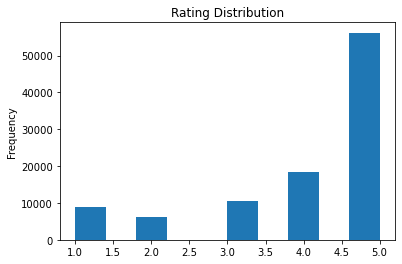

In [27]:
df['overall'].plot(kind='hist', title='Rating Distribution')

In [28]:
# handle class imbalance problem
rus  = RandomUnderSampler(random_state=42)
df_final, _ = rus.fit_resample(df, df['overall'])
df_final = pd.DataFrame(df_final, columns=['overall','reviewText'])
df_final.shape

(30380, 2)

In [29]:
df_final.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 30380 entries, 0 to 30379
Data columns (total 2 columns):
 #   Column      Non-Null Count  Dtype 
---  ------      --------------  ----- 
 0   overall     30380 non-null  int32 
 1   reviewText  30380 non-null  object
dtypes: int32(1), object(1)
memory usage: 356.1+ KB


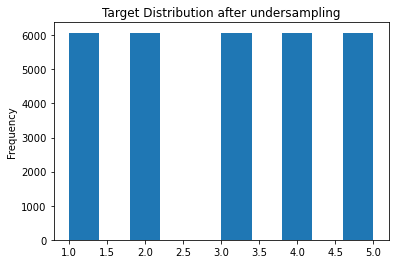

In [30]:
df_final['overall'].plot(kind='hist', title='Target Distribution after undersampling');

## Data analysis and preprocessing for all datasets

In [31]:
def process_data(data_array, data_name):
  # convert list into pandas dataframe
  print('######[ Processing', data_name, 'Data ]######')

  df = pd.DataFrame.from_dict(data_array)
  df = df[['overall', 'reviewText']]

  print("Unique Rating : ", df['overall'].unique())

  df = df[df['reviewText'].notna()]

  # convert target type from float to int
  df = df.astype({'overall': 'int32'})

  df['overall'].plot(kind='hist', title='Rating Distribution of {}'.format(data_name))
  plt.show()

  # handle class imbalance problem
  rus  = RandomUnderSampler(random_state=42)
  df, _ = rus.fit_resample(df, df['overall'])
  df = pd.DataFrame(df, columns=['overall','reviewText'])
  print('Final size of data :', len(df), '\n')

  # convert target type from float to int
  df = df.astype({'overall': 'int32'})

  df['overall'].plot(kind='hist', title='Target Distribution after undersampling of {}'.format(data_name));
  plt.show()

  return df

######[ Processing Cell_Phones_and_Accessories Data ]######
Unique Rating :  [5. 3. 2. 4. 1.]


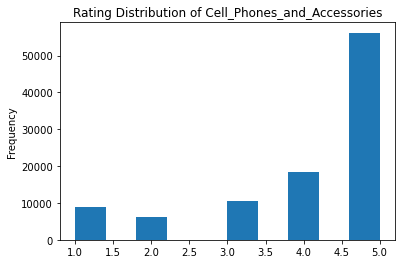

Final size of data : 30380 



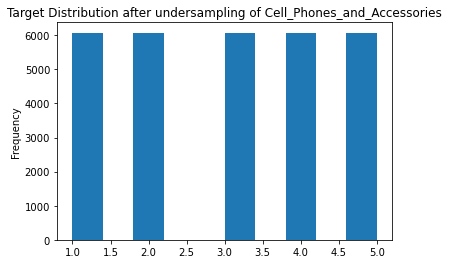

######[ Processing Arts_Crafts_and_Sewing Data ]######
Unique Rating :  [4. 5. 2. 3. 1.]


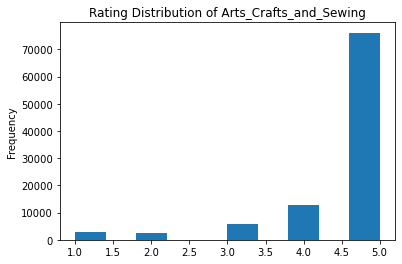

Final size of data : 12955 



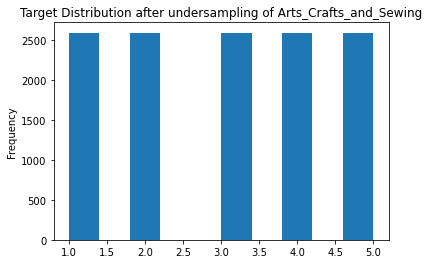

######[ Processing Clothing_Shoes_and_Jewelry Data ]######
Unique Rating :  [5. 4. 2. 3. 1.]


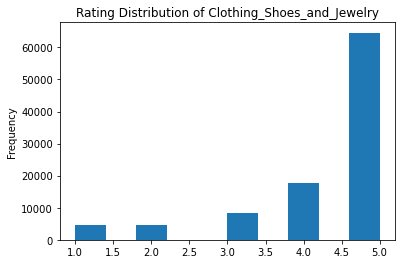

Final size of data : 22750 



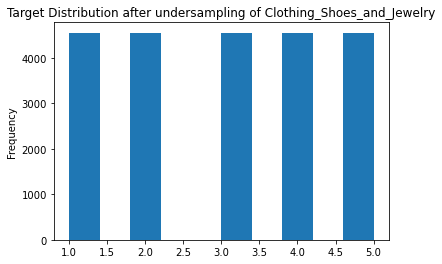

######[ Processing Books Data ]######
Unique Rating :  [5. 3. 2. 4. 1.]


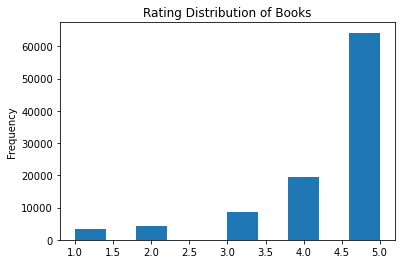

Final size of data : 17420 



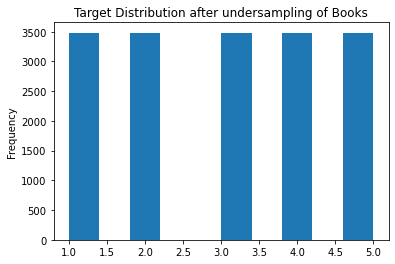

######[ Processing Electronics Data ]######
Unique Rating :  [5. 3. 4. 2. 1.]


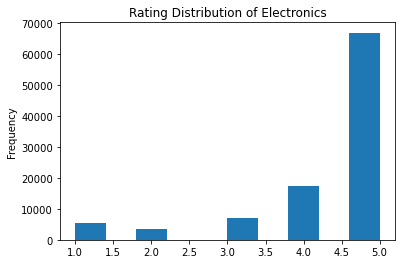

Final size of data : 17525 



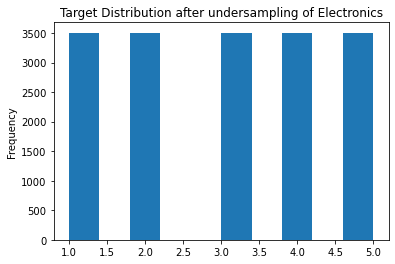

######[ Processing Kindle_Store Data ]######
Unique Rating :  [4. 5. 3. 2. 1.]


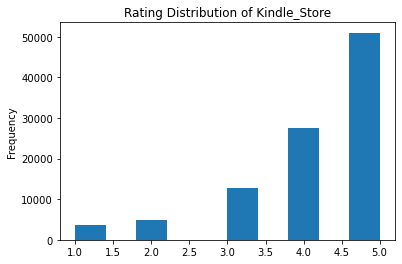

Final size of data : 18655 



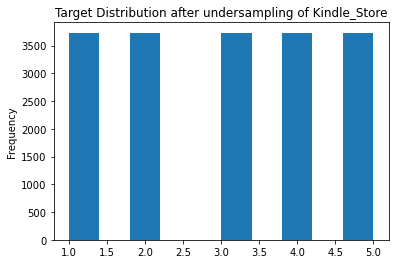

######[ Processing Sports_and_Outdoors Data ]######
Unique Rating :  [5. 1. 4. 3. 2.]


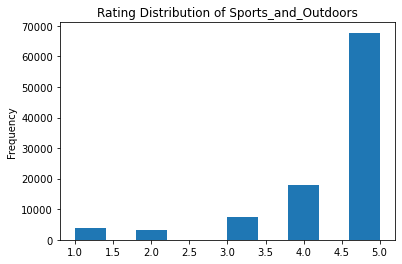

Final size of data : 16610 



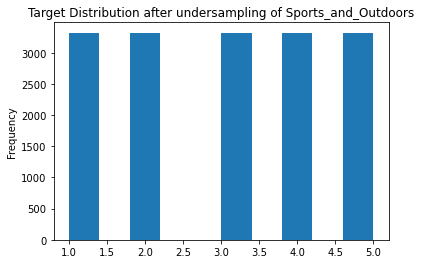

######[ Processing Toys_and_Games Data ]######
Unique Rating :  [5. 4. 2. 1. 3.]


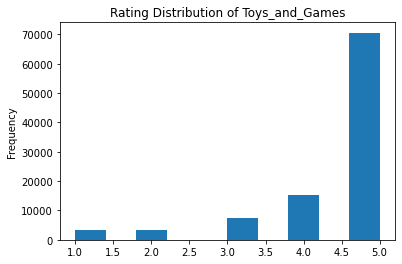

Final size of data : 16630 



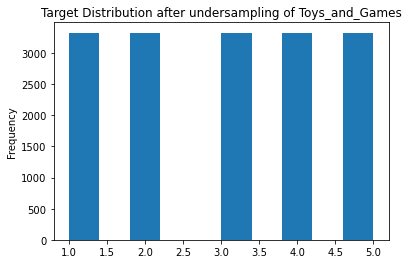

In [32]:
processed_data = {}
for data_name, data_array in data.items():
  processed_data[data_name] = process_data(data_array, data_name)

In [33]:
# Marge the data of all catagories to a single dataframe
final_data = pd.concat(processed_data.values())
final_data.shape

(152925, 2)

In [34]:
# converting rationg to binary labels (1 = Good, 0 = Bad)
y = final_data.iloc[:, 0].values > 2
y = np.array([int(i) for i in y])

In [35]:
# split data into training and validation set in ratio of 9:1
X_train, X_test, Y_train, Y_test = train_test_split(final_data['reviewText'], y, random_state=42, train_size=0.9, stratify=y)

print('No. of samples Training data :', X_train.shape[0])
print('No. of samples Validation data :', X_test.shape[0])

No. of samples Training data : 137632
No. of samples Validation data : 15293


## Tenosrflow word preprocessing

In [36]:
vocab_size = 5000
embedding_dim = 16
max_length = 120
trunc_type='post'
oov_tok = "<OOV>"

In [37]:
tokenizer = Tokenizer(num_words = vocab_size, oov_token=oov_tok)
tokenizer.fit_on_texts(X_train)
word_index = tokenizer.word_index

sequences = tokenizer.texts_to_sequences(X_train)
padded = pad_sequences(sequences, maxlen=max_length, truncating=trunc_type)

testing_sequences = tokenizer.texts_to_sequences(X_test)
testing_padded = pad_sequences(testing_sequences, maxlen=max_length)

In [38]:
reverse_word_index = dict([(value, key) for (key, value) in word_index.items()])

def decode_review(text):
    return ' '.join([reverse_word_index.get(i, '?') for i in text])

print(decode_review(padded[1]))
print(X_train[1])

? ? ? ? ? ? ? ? ? ? ? ? ? ? ? ? ? ? ? ? ? ? ? ? ? ? ? ? ? ? ? ? ? ? ? ? ? ? ? ? ? ? ? ? ? ? ? ? ? ? ? ? ? ? ? ? ? ? ? ? ? ? ? ? ? ? ? ? ? ? ? ? ? ? ? ? ? ? ? ? ? ? ? ? ? ? ? ? ? ? ? ? ? save your money and invest in an otterbox this is a poor <OOV> at a great product the plastic is cheap and the rubber doesn't fit properly
1    Characters you don't care about, exposition in...
1    This is a rugged case, but you will not be abl...
1                        pile of garbage, don't buy it
1    but definitly NOT...  tiny book..  make robot ...
1    From buying this totally waste of technology. ...
1    I am so frustrated with Anita Shreve.  I canno...
1    The only thing nice I can say is it is made of...
1                                           Toxic??!!!
Name: reviewText, dtype: object


In [39]:
padded.shape

(137632, 120)

## Model Training

In [40]:
# Model Definition with Conv1D

inputs = tf.keras.Input(shape=(max_length))
x = tf.keras.layers.Embedding(vocab_size, embedding_dim, input_length=max_length)(inputs)
x = tf.keras.layers.Conv1D(120, 5, activation='relu')(x)
x = tf.keras.layers.GlobalAveragePooling1D()(x)
x = tf.keras.layers.Dense(32, activation='relu')(x)
outputs =  tf.keras.layers.Dense(1, activation='sigmoid')(x)
model = tf.keras.models.Model(inputs, outputs)

opt = tf.keras.optimizers.Adam(learning_rate=0.0001)
model.compile(loss='binary_crossentropy', optimizer=opt, metrics=['accuracy'])
plot_model(model, to_file="model_plot.png", show_shapes=True)
model.summary()

You must install pydot (`pip install pydot`) and install graphviz (see instructions at https://graphviz.gitlab.io/download/) for plot_model/model_to_dot to work.
Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 120)]             0         
                                                                 
 embedding (Embedding)       (None, 120, 16)           80000     
                                                                 
 conv1d (Conv1D)             (None, 116, 120)          9720      
                                                                 
 global_average_pooling1d (G  (None, 120)              0         
 lobalAveragePooling1D)                                          
                                                                 
 dense (Dense)               (None, 32)                3872      
                               

In [41]:
num_epochs = 20
history = model.fit(padded, Y_train, epochs=num_epochs, validation_data=(testing_padded, Y_test))

Epoch 1/20
4301/4301 [==============================] - 65s 12ms/step - loss: 0.5694 - accuracy: 0.6988 - val_loss: 0.4819 - val_accuracy: 0.7638
Epoch 2/20
4301/4301 [==============================] - 50s 12ms/step - loss: 0.4528 - accuracy: 0.7873 - val_loss: 0.4480 - val_accuracy: 0.7842
Epoch 3/20
4301/4301 [==============================] - 45s 10ms/step - loss: 0.4295 - accuracy: 0.8005 - val_loss: 0.4361 - val_accuracy: 0.7934
Epoch 4/20
4301/4301 [==============================] - 44s 10ms/step - loss: 0.4180 - accuracy: 0.8071 - val_loss: 0.4313 - val_accuracy: 0.7983
Epoch 5/20
4301/4301 [==============================] - 57s 13ms/step - loss: 0.4106 - accuracy: 0.8123 - val_loss: 0.4270 - val_accuracy: 0.8013
Epoch 6/20
4301/4301 [==============================] - 48s 11ms/step - loss: 0.4051 - accuracy: 0.8159 - val_loss: 0.4241 - val_accuracy: 0.8017
Epoch 7/20
4301/4301 [==============================] - 46s 11ms/step - loss: 0.4009 - accuracy: 0.8180 - val_loss: 0.4219 -

In [42]:
model.save('/content/drive/MyDrive/Colab Notebooks/Amazon Review/model_new_1.h5')

## Evaluate Model Performance

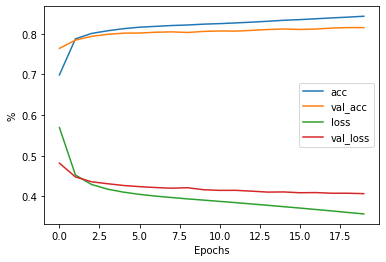

In [43]:
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.xlabel("Epochs")
plt.ylabel('%')
plt.legend(['acc', 'val_acc', 'loss', 'val_loss'])
plt.show()

In [44]:
from sklearn.metrics import confusion_matrix, classification_report

y_pred = model.predict(testing_padded)
y_pred = y_pred > .5


print(classification_report(Y_test, y_pred))

              precision    recall  f1-score   support

           0       0.76      0.78      0.77      6117
           1       0.85      0.84      0.84      9176

    accuracy                           0.81     15293
   macro avg       0.81      0.81      0.81     15293
weighted avg       0.82      0.81      0.82     15293



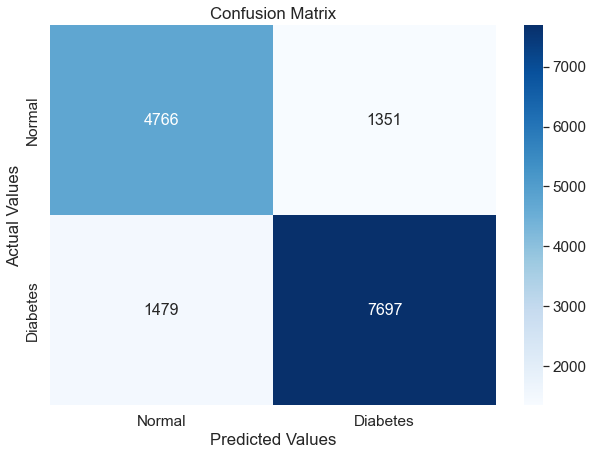


acc: 0.8149 	sensitivity: 0.7791 	specificity: 0.8388




In [45]:
cm = confusion_matrix(Y_test, y_pred)
plt.figure(figsize=(10,7))
sns.set(font_scale=1.4)
sns.heatmap(cm,
            annot=True,
            annot_kws={"size": 16},
            xticklabels=['Normal', 'Diabetes'],  
            yticklabels=['Normal', 'Diabetes'],
            fmt='g',
            cmap='Blues')
plt.title('Confusion Matrix')
plt.ylabel('Actual Values')
plt.xlabel('Predicted Values')
plt.savefig("/content/CM.png")
plt.show()

total = np.sum(cm)

TP, FN, FP, TN = cm[0, 0], cm[0, 1], cm[1, 0], cm[1, 1]

acc = (TP + TN) / total
sensitivity = TP / (TP+FN)
specificity = TN / (TN+FP)

print("\nacc: {:.4f}".format(acc),"\tsensitivity: {:.4f}".format(sensitivity),"\tspecificity: {:.4f}\n\n".format(specificity))

In [46]:
#Testing with custom input 
your_review = "the product is good, i am satisfied with it"

In [47]:
your_padded_review = pad_sequences(tokenizer.texts_to_sequences([your_review]), maxlen=max_length, truncating=trunc_type)
prediction = model.predict(your_padded_review)[0][0]

if prediction > 0.5:
  print('good')
else:
  print('not good')

prediction

good


0.98966336

In [48]:
your_review = "the product is vary bad, do not buy this"

In [49]:
your_padded_review = pad_sequences(tokenizer.texts_to_sequences([your_review]), maxlen=max_length, truncating=trunc_type)
prediction = model.predict(your_padded_review)[0][0]

if prediction > 0.5:
  print('good')
else:
  print('not good')

prediction

not good


0.052690506